# CS109 Final Project
# *US Housing Market Analysis and Prediction 1996-2014* 
### Jordan Rogers, Alex Harding, and Eric Rodrigo








# Project Overview and Related Work:
We set out to see how housing prices varied across time and across location. Specifically, we looked into the median home prices single family detached dwellings. We used the median and not the mean because the median is robust to outliers which are ever-present in the real-estate industry with some mansions selling for hundreds of millions of dollars. In a given year, we explored which various factors, such as crime and age, affected housing prices the most. We also tested the strength of these features by doing various exploratory analysis to see if we could accurately predict home prices using training and testing sets. We were also very interested to see how housing prices changed across the time period of the mortgage crisis of 2008 and the resulting recession. We created some nice visualizations that showed which regions were affected by the “bubble” the most and which regions remained relatively stable across the time period of 1996-2014. The Economist has an interesting article which also explores real-estate data. http://www.economist.com/blogs/graphicdetail/2015/11/daily-chart-0


# Background and Motivation:
Housing prices are strong indicators of the status of the U.S. economy. We thought it would be very interesting to see the relationship between the economic business cycle and housing prices. Also, this analysis will help visualize how housing prices varied across the different regions of the United States. For example, it would be very interesting to see how the Silicon Valley tech boom affect home prices in California. 

Home investors take many factors into account when choosing which areas to invest in. We figured it would be very interesting to see which factors carry the most weight in affecting home prices in an area. We hope that an investor could use our analysis to make a more educated decision about which homes to put money into.



# Initial Questions: 
We had many questions we were interested in exploring, however we had two main questions:
<li>How did housing prices change leading up to and after the 2008 economic bust. 
<li>Which factors affect housing prices the most in a given area. 

As the project progressed we developed other questions which we aimed to answer:
<li>How volatile were housing prices over the past 15 years?
<li>Which areas were most affected by the 2008 housing bubble? 
<li>How do housing prices vary across regions? 

This last question arose after we had done a lot of exploratory analysis on the United States as a whole and realized that the accuracy of our tests largely depended on which regions happened to be in the training sets and which regions were not. We realized that overall there were large gaps in average prices across the entire dataset, so we did exploratory analysis on each region individually. 

#Exploratory data analysis: 
We used a lot of scatter plots and histograms initially to understand how well our prediction methods were doing initially. After we found the model that worked best for our data we used dot-plots and heat maps/slide shows to visualize how our data was distributed by region (we previously made no distinction). After creating the regional visualizations it became clear that the region, especially in the year we primarily worked with, played a large factor in predicting the price. Since we already had our best regression model from the whole US analysis we simply turned it onto each individual region and found that provided with enough data we could be far more accurate. 

#*Final analysis*:
Predicting the median housing price of a county given various economic, social, and demographic information is incredibly hard to do accurately. A lack of adequate data for every county in the US may have played a small role in the imprecision as we did not have as large of a dataset as we initially thought we might. That being said, we still had nearly 800 entries and our top regression model, the random forest regression, was able to consistently achieve 55-60% accuracy (depending on the test/train split), which was a 15-20% increase from our baseline, least-squares regression method. Splitting the data by region allowed us to boost these results even more and achieve 80+% accuracy depending on region (The prediction accuracy for the Northeast, for instance, was particularly influenced by this split).

We were limited by the availability of demographic data, which was only thoroughly available on a per county basis throughout the US. However, we believe that provided with adequate data at a more local/city/town based level we would still be able to apply our methods and utilize it for predicting the economic health of the area (by looking at the changes in short (~3-6 months) time) or use it to target regions for real-estate investment for personal profit. 

By analyzing the volatility of housing prices on a county level before, during, and after the subprime mortgage crisis in 2007, we now understand that the most significant variation in housing prices occurred around the coasts, specifically in FL and CA when we consider the volatility as a percentage of home price. As an investor, this sort of housing market volatility in these regions can be both a blessing and a curse, leading to significant profits if you buy when prices are cheapest, but staggering losses if you decide to invest when the market is peaking. In addition, through our temporal analysis of the housing market over the nineteen year period from 1996-2014, we have gained greater insight into regional market differences and the overall trends that this important facet of the national economy has undergone, especially during a time as critical as the subprime mortgage crisis and national recession.


### Import different toolkits:

In [10]:
%matplotlib inline
import numpy as np
import scipy as sp
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import pandas as pd
pd.set_option('display.width', 500)
pd.set_option('display.max_columns', 100)
pd.set_option('display.notebook_repr_html', True)
import seaborn as sns
from IPython.display import Image
sns.set_style("whitegrid")
sns.set_context("poster")

## Note to TF: You can forego running most of the code in the first part of the notebook if you scroll down to the heading entitled "Saved Dataframe" and follow the instructions there. Thanks!

### We will be creating visualizations for housing prices from 1998-2013, but predicting pricing with real estate and demographic data from only December 2010 because we can make the reasonable assumption that the 2010 census data will be fairly accurate at that point in time.


In [2]:
# function to change all state names to their abbreviations and remove "county" from county names
# adapted from: http://stackoverflow.com/questions/33507236/iterating-through-rows-of-pandas-dataframe-change-series-value-based-on-values
def fix_census_naming(df, data_name, state_abbr):
    # map each written state name to its abbreviation with a dictionary we create
    df['State'] = df.apply(lambda x: state_abbr.get(x['State']), axis=1)
    # take off "County" at the end of the county name for consistency
    df['County'] = df['County'].apply(lambda x: x.rstrip('County'))
    # drop counties that don't have data 
    df = df.dropna(axis=0,how='any')
    # make new column with county and state name because some county names are repeated across states
    for index,row in df.iterrows():
        # make sure there are no spaces in the location so it's all standardized (fixes inconsistency issues in naming) 
        location = (row['County']+','+row['State']) 
        location = location.replace(" ", "")
        # also make the whole location lowercase so everything is consistent 
        df.loc[index,'Location'] = location.lower()
    # df.drop(['State','County'],axis=1)
    df = df[['Location','Value']]
    df.columns = ['Location', data_name]
    return df

In [3]:
# function that only fixes the naming issue, doesn't create a smaller dataframe (for combined CSVs)
def fix_census_naming_partial(df, state_abbr):
    df['State'] = df.apply(lambda x: state_abbr.get(x['State']), axis=1)
    df['County'] = df['County'].apply(lambda x: x.rstrip('County'))
    # drop counties that don't have data 
    df = df.dropna(axis=0,how='any')
    # make new column with county and state name because some county names are repeated across states
    for index,row in df.iterrows():
        # make sure there are no spaces in the location so it's all standardized (fixes inconsistency issues in naming) 
        location = (row['County']+','+row['State']) 
        location = location.replace(" ", "")
        # also make the whole location lowercase so everything is consistent 
        df.loc[index,'Location'] = location.lower()
    # df[['Location','Asian','Black','Hispanic','Native American','White','Other']]
    #df.columns = ['Location', 'Asian','Black','Hispanic','Native American','White','Other']
    return df[['Location','Asian','Black','Hisp. Or Lat.','Native American','White','Other']]

In [4]:
def clean_zillow_df(filename):
    df = pd.read_csv(filename)
    # take only data from December 2010
    df = pd.concat([df['RegionName'],df['State'],df['2010-12']],axis=1, keys=['County','State','Price'])
    # drop counties that don't have data 
    df = df.dropna(axis=0,how='any')
    # make new column with county and state name because some county names are repeated across states
    for index,row in df.iterrows():
        # make sure there are no spaces in the location so it's all standardized (fixes inconsistency issues in naming) 
        location = (row['County']+','+row['State']) 
        location = location.replace(" ", "")
        # also make the whole location lowercase so everything is consistent 
        df.loc[index,'Location'] = location.lower()
    # remove the state and county columns now that we've created one for the unique location
    df = df.drop(df.columns[[0,1]],axis=1)
    #df.drop(['State','County'],axis=1)
    return df[['Location','Price']]

In [5]:
def clean_census_df(filename, data_name, state_abbr):
    df = pd.read_csv(filename)
    df = fix_census_naming(df, data_name, state_abbr)
    return df

In [6]:
def clean_census_df_partial(filename,state_abbr):
    df = pd.read_csv(filename)
    df = fix_census_naming_partial(df, state_abbr)
    return df

### Read in and clean up largest housing price dataframe from Zillow.com:

In [7]:
# first let's get the housing data ones from zillow
county_prices=pd.read_csv("single_family_prices_county.csv")
county_prices.head()
# make a list of the the columns we want to keep
good_cols = ['RegionName','State','1996-12','1997-12','1998-12','1999-12','2000-12','2001-12','2002-12','2003-12','2004-12','2005-12','2006-12','2007-12','2008-12','2009-12','2010-12','2011-12','2012-12','2013-12','2014-12']
#good_cols = ['RegionName', 'State', 1996, 1997, 1998, 1999,2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014]
# drop columns that we don't care about
county_prices = county_prices[good_cols]

# drop any counties that don't contain data for all the columns we're keeping 
county_prices = county_prices.dropna(axis=0,how='any')

# make new column with county and state name because some county names are repeated across states 
# (didn't use func here bc we want all months of pricing for this dataframe)
for index,row in county_prices.iterrows():
    location = (row['RegionName']+','+row['State']) 
    location = location.replace(" ", "")
    # also make the whole location lowercase so everything is consistent 
    county_prices.loc[index,'Location'] = location.lower() 

# we'll use the housing_by_zip dataframe later on when we start looking at housing price trends over the years
county_prices = county_prices.drop(county_prices.columns[[0,1]],axis=1)

# save the dataframe so we don't have to run this code every time
county_prices.to_pickle('county_prices.pkl')

# make another dataframe with only the data from December 2010 (the month we will be predicting on)
small_pricedf = clean_zillow_df('single_family_prices_county.csv')

### Create dictionary with state abbreviations so we can standardize naming later on:

In [9]:
# load in csv with state abbreviations
state_abbr = pd.read_csv("state_abbr.csv")
# convert to a dictionary for easy indexing
state_abbr = state_abbr.set_index('State')['Abbreviation'].to_dict()

### Read in and clean the other CSV files (takes about 9min to run on my laptop):

In [10]:
%%time
# # will have to think more about whether to use foreclosure as a feature (because there's a good bit of the data missing)
# foreclosed = clean_zillow_df('foreclosed_homes.csv')

# percent of listings with a price cut
price_cut_percent = clean_zillow_df('price_cut.csv')
# convert to individual dictionaries for easy indexing later on
price_cut_perc_dict = price_cut_percent.set_index('Location')['Price'].to_dict()

# median price cut 
median_price_cut = clean_zillow_df('median_price_cut.csv')
median_price_cut_dict = median_price_cut.set_index('Location')['Price'].to_dict()

# # ###### also not sure if we should use sold for loss and sold for gain
# # ###### they only have 140 elements, and I'm not sure how best to handle the cases where there's no data
# # ###### maybe let's put more focus on the demographics data

# # percent of houses sold for a loss
# sold_for_loss = clean_zillow_df('sold_for_loss.csv')
# # percent sold for a gain
# sold_for_gain = clean_zillow_df('sold_for_gain.csv')

# median age in each county
median_age = clean_census_df("median_age_county.csv",'Median Age',state_abbr)
median_age_dict = median_age.set_index('Location')['Median Age'].to_dict()

# # percent 65+ years old in each county
over_64 = clean_census_df("percent_65_and_older_county.csv",'Percent 65+',state_abbr)
over_64_dict = over_64.set_index('Location')['Percent 65+'].to_dict()

# average family size
avg_family_size = clean_census_df("avg_family_size.csv", 'Avg. Family Size',state_abbr)
fam_size_dict = avg_family_size.set_index('Location')['Avg. Family Size'].to_dict()

# create dataframe with racial breakdown for each county (we combined the separate csv files in excel so the program
# wouldn't take as long to run)
race_df = clean_census_df_partial("race_percents_2.csv",state_abbr)
race_dict = race_df.set_index('Location').to_dict()

# homeowner vacancy rates 
vacancy_rate = clean_census_df("vacancy_rate.csv", 'Vacancy Rate', state_abbr)
vacancy_dict = vacancy_rate.set_index('Location')['Vacancy Rate'].to_dict()

# percent of occupied housing units
occupied_rate = clean_census_df("percent_occupied.csv",'Percent Occupied Units',state_abbr)
occupied_dict = occupied_rate.set_index('Location')['Percent Occupied Units'].to_dict()

# the population data we are using is from April of 2000 and 2010, so we are assuming the county populations don't
# change significantly between April of 2010 and December of the same year (which isn't too far-fetched)

# population change from 2000 -> 2010
pop_change = clean_census_df("population_change.csv", '2000 -> 2010 Pop. Change',state_abbr)
pop_change_dict = pop_change.set_index('Location')['2000 -> 2010 Pop. Change'].to_dict()

# pop. change percent from 2000 -> 2010
pop_change_percent = clean_census_df("population_change_percent.csv",'Pop. Change %',state_abbr)
pop_percent_dict = pop_change_percent.set_index('Location')['Pop. Change %'].to_dict()

# # population in April 2010
pop_2010 = clean_census_df("population_2010.csv",'Population',state_abbr)
pop_2010_dict = pop_2010.set_index('Location')['Population'].to_dict()

CPU times: user 8min 46s, sys: 2.27 s, total: 8min 48s
Wall time: 8min 50s


/Users/ericrodrigo/anaconda/lib/python2.7/site-packages/pandas/core/indexing.py:249: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
/Users/ericrodrigo/anaconda/lib/python2.7/site-packages/pandas/core/indexing.py:415: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


### Read in the crime data, listed as the number of occurences of each crime by county (we will normalize this further down to account for population size):

In [11]:
crime_data = pd.read_csv('edited_crime_data2.csv')
# drop any incomplete rows
crime_data = crime_data.dropna(axis=0,how='any')

# fix the state naming (is initially in all caps)
for index,row in crime_data.iterrows():
    # make all caps name lowercase, then capitalize as a title and strip off trailing spaces
    edited_state = row['State'].lower().title().rstrip()
    crime_data.loc[index,'State'] = edited_state
# drop counties that don't have data 
crime_data = crime_data.dropna(axis=0,how='any')

# map each state name to its abbreviation
crime_data['State'] = crime_data.apply(lambda x: state_abbr.get(x['State']), axis=1)

for index,row in crime_data.iterrows():
    # make sure there are no spaces in the location so it's all standardized (fixes inconsistency issues in naming) 
    location = (row['County']+','+row['State']) 
    location = location.replace(" ", "")
    # also make the whole location lowercase so everything is consistent 
    crime_data.loc[index,'Location'] = location.lower()

crime_data = crime_data[['Location','Type','Violent crime','Property crime']]
crime_dict = crime_data.set_index('Location').to_dict()

### Make dictionary with latitudes and longitudes:

In [12]:
# csv with latitude and longitude data for each county
lat_longs = pd.read_csv("lats_longs.csv")
# make new column with county and state name because some county names are repeated across states
for index,row in lat_longs.iterrows():
    loc = (row['county']+', '+row['state']).replace(" ","").lower()
    lat_longs.loc[index,'FullName'] = loc
    
grouped_lats = lat_longs.groupby('FullName')

lat_lst = []
long_lst = []
county_lst = []

# iterate through zip codes in the same county and average their latitude and longitude to get general loc for county
for name, group in grouped_lats:
    lat_lst.append(np.mean(group['latitude']))
    long_lst.append(np.mean(group['longitude']))
    county_lst.append(name)
# make dictionary with county as key and latitude and longitude as value tuple
lat_long_dict = dict(zip(county_lst,zip(lat_lst,long_lst)))

### Now let's add all the feature data into the larger dataframe from the individual dictionaries: 

In [13]:
for index,row in small_pricedf.iterrows():
    l = row['Location']
    # only update the locations where the other demographics dictionaries have data
    # sorry for the messy formatting of this if statement, couldn't wrap the line
    if (l in lat_long_dict) & (l in median_age_dict) & (l in over_64_dict) & (l in race_dict.get('Asian')) & (l in fam_size_dict) & (l in price_cut_perc_dict) & (l in median_price_cut_dict) & (l in vacancy_dict) & (l in occupied_dict) & (l in pop_change_dict) & (l in pop_percent_dict) & (l in pop_2010_dict) & (l in crime_dict.get('Violent crime')):
        small_pricedf.loc[index,'Latitude'] = lat_long_dict.get(l)[0]
        small_pricedf.loc[index,'Longitude'] = lat_long_dict.get(l)[1]
        small_pricedf.loc[index,'Median Age'] = median_age_dict.get(l)
        small_pricedf.loc[index,'% 65+ Years Old'] = over_64_dict.get(l)
        small_pricedf.loc[index,'% Asian'] = race_dict.get('Asian').get(l)
        small_pricedf.loc[index,'% Black'] = race_dict.get('Black').get(l)
        small_pricedf.loc[index,'% Hispanic'] = race_dict.get('Hisp. Or Lat.').get(l)
        small_pricedf.loc[index,'% Native American'] = race_dict.get('Native American').get(l)
        small_pricedf.loc[index,'% White'] = race_dict.get('White').get(l)
        small_pricedf.loc[index,'% Other Race'] = race_dict.get('Other').get(l)
        small_pricedf.loc[index,'Family Size'] = fam_size_dict.get(l)
        small_pricedf.loc[index,'% w/ Price Cut'] = price_cut_perc_dict.get(l)
        small_pricedf.loc[index,'Median Price Cut'] = median_price_cut_dict.get(l)
        small_pricedf.loc[index,'Homeowner Vacancy Rate'] = vacancy_dict.get(l)
        small_pricedf.loc[index,'Percent Occupied Units'] = occupied_dict.get(l)
        small_pricedf.loc[index,'2000 -> 2010 Pop. Change'] = pop_change_dict.get(l)
        small_pricedf.loc[index,'Pop. Change %'] = pop_percent_dict.get(l)
        small_pricedf.loc[index,'Population'] = pop_2010_dict.get(l)   
        small_pricedf.loc[index,'Violent Crime Rate'] = crime_dict.get('Violent crime').get(l) 
        small_pricedf.loc[index,'Property Crime Rate'] = crime_dict.get('Property crime').get(l)
        small_pricedf.loc[index,'Metropolitan Area?'] = (crime_dict.get('Type').get(l) == 'Metro')
        
# remove any rows that aren't complete
full_2010df = small_pricedf.dropna(axis=0,how='any')
# we're working with a dataset has 22 features and 759 counties
# reset the dataframe index, dropping the column it creates
full_2010df = full_2010df.reset_index(drop=True)

In [14]:
full_2010df.head() 

,Location,Price,Latitude,Longitude,Median Age,% 65+ Years Old,% Asian,% Black,% Hispanic,% Native American,% White,% Other Race,Family Size,% w/ Price Cut,Median Price Cut,Homeowner Vacancy Rate,Percent Occupied Units,2000 -> 2010 Pop. Change,Pop. Change %,Population,Violent Crime Rate,Property Crime Rate,Metropolitan Area?
0,"losangeles,ca",394500,33.800378,-118.279269,34.8,10.9,13.7,8.7,47.7,0.7,50.3,21.8,3.58,12.109844,5.000000,1.7,94.1,299267,3.1,9818605,6497,17310,True
1,"harris,tx",128400,29.804557,-95.401775,32.2,8.1,6.2,18.9,40.8,0.7,56.6,14.3,3.43,11.711242,4.473684,2.3,89.8,691881,20.3,4092459,8089,55841,True
2,"maricopa,az",148300,33.312858,-112.093194,34.6,12.1,3.5,5.0,29.6,2.1,73.0,12.8,3.25,18.818502,5.489692,4.1,86.1,744968,24.2,3817117,989,5117,True
3,"sandiego,ca",393600,32.929999,-116.950879,34.6,11.4,10.9,5.1,32.0,0.9,64.0,13.6,3.31,14.730794,4.555809,1.9,93.3,281480,10.0,3095313,1432,5985,True
4,"orange,ca",539200,33.633705,-117.761154,36.2,11.6,17.9,1.7,33.7,0.6,60.8,14.5,3.47,13.400608,4.166667,1.4,94.6,163943,5.8,3010232,187,1275,True


#### As mentioned above, we need to normalize the crime data as a per 100,000 people float. We'll also adjust the housing prices to thousands of dollars and convert the True/False Metro value to 1/-1 respectively. We'll also add a new column for the total crime rate. 

In [15]:
full_2010df["Violent Crime Rate"] = full_2010df["Violent Crime Rate"]/(full_2010df['Population']/100000.)
full_2010df["Property Crime Rate"] = full_2010df["Property Crime Rate"]/(full_2010df['Population']/100000.)
full_2010df['Price'] = full_2010df['Price']/1000.

tfs = full_2010df['Metropolitan Area?'].values
inds = []
for x in tfs:
    if x: inds.append(1.)
    else: inds.append(-1.)
full_2010df['Metropolitan Area?'] = inds

full_2010df['Crime Rate'] = full_2010df["Violent Crime Rate"]+full_2010df["Property Crime Rate"]

full_2010df.head()

,Location,Price,Latitude,Longitude,Median Age,% 65+ Years Old,% Asian,% Black,% Hispanic,% Native American,% White,% Other Race,Family Size,% w/ Price Cut,Median Price Cut,Homeowner Vacancy Rate,Percent Occupied Units,2000 -> 2010 Pop. Change,Pop. Change %,Population,Violent Crime Rate,Property Crime Rate,Metropolitan Area?,Crime Rate
0,"losangeles,ca",394.5,33.800378,-118.279269,34.8,10.9,13.7,8.7,47.7,0.7,50.3,21.8,3.58,12.109844,5.000000,1.7,94.1,299267,3.1,9818605,66.170296,176.297957,1,242.468253
1,"harris,tx",128.4,29.804557,-95.401775,32.2,8.1,6.2,18.9,40.8,0.7,56.6,14.3,3.43,11.711242,4.473684,2.3,89.8,691881,20.3,4092459,197.656226,1364.485264,1,1562.141490
2,"maricopa,az",148.3,33.312858,-112.093194,34.6,12.1,3.5,5.0,29.6,2.1,73.0,12.8,3.25,18.818502,5.489692,4.1,86.1,744968,24.2,3817117,25.909607,134.054052,1,159.963658
3,"sandiego,ca",393.6,32.929999,-116.950879,34.6,11.4,10.9,5.1,32.0,0.9,64.0,13.6,3.31,14.730794,4.555809,1.9,93.3,281480,10.0,3095313,46.263496,193.356859,1,239.620355
4,"orange,ca",539.2,33.633705,-117.761154,36.2,11.6,17.9,1.7,33.7,0.6,60.8,14.5,3.47,13.400608,4.166667,1.4,94.6,163943,5.8,3010232,6.212146,42.355539,1,48.567685


#### Let's check to make sure all of our features are the types we want

In [16]:
full_2010df.dtypes

Location                     object
Price                       float64
Latitude                    float64
Longitude                   float64
Median Age                  float64
% 65+ Years Old             float64
% Asian                     float64
% Black                     float64
% Hispanic                  float64
% Native American           float64
% White                     float64
% Other Race                float64
Family Size                 float64
% w/ Price Cut              float64
Median Price Cut            float64
Homeowner Vacancy Rate      float64
Percent Occupied Units      float64
2000 -> 2010 Pop. Change    float64
Pop. Change %               float64
Population                  float64
Violent Crime Rate          float64
Property Crime Rate         float64
Metropolitan Area?          float64
Crime Rate                  float64
dtype: object

Let's save this dataframe to our folder so we don't have to run the big blocks of code everytime. You'll also have to run "Create dictionary with state abbreviations so we can standardize naming later on:" block of code towards the top of pset as well as the first block of code that imports numpy, scikit, etc. 

In [17]:
# uncomment the link of code below to save full_2010df to a file
#full_2010df.to_pickle('full_2010df.pkl')

# Saved Dataframe:

### Run the code below to load the dataframes from the local folder:
Also run code under headings (above): 
* "Create dictionary with state abbreviations so we can standardize naming later on"
* "Import different toolkits"

In [18]:
full_2010df = pd.read_pickle('full_2010df.pkl')
county_prices = pd.read_pickle('county_prices.pkl')

In [19]:
county_prices.head()

,1996-12,1997-12,1998-12,1999-12,2000-12,2001-12,2002-12,2003-12,2004-12,2005-12,2006-12,2007-12,2008-12,2009-12,2010-12,2011-12,2012-12,2013-12,2014-12,Location
0,165000,171000,188500,205700,228000,253800,306100,374900,476800,569300,577000,530400,421400,403900,394500,372300,397800,474300,499900,"losangeles,ca"
1,139200,141800,146700,157300,171900,188200,206800,228700,252200,276200,286400,273400,240300,219600,198600,176000,176200,193900,204700,"cook,il"
2,76100,83600,89000,97700,99400,101100,108600,112300,127900,130400,136300,138700,131200,133200,128400,128500,136200,144800,148100,"harris,tx"
3,114700,121100,127900,136800,143500,149100,159300,168100,203800,293500,285800,257900,205800,175500,148300,152600,185500,214800,220000,"maricopa,az"
4,176000,187500,212500,235500,274200,308600,374200,442500,560000,576200,551100,504500,416500,407300,393600,374400,408700,485200,504700,"sandiego,ca"


### Out of curiosity, lets see which counties have the highest average house prices.

In [20]:
rankedcounties = full_2010df.sort('Price',ascending=False)

In [21]:
def autolabel(rects):
    # attach some text labels
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2., 1.05*height,
                '%d' % int(height),
                ha='center', va='bottom')

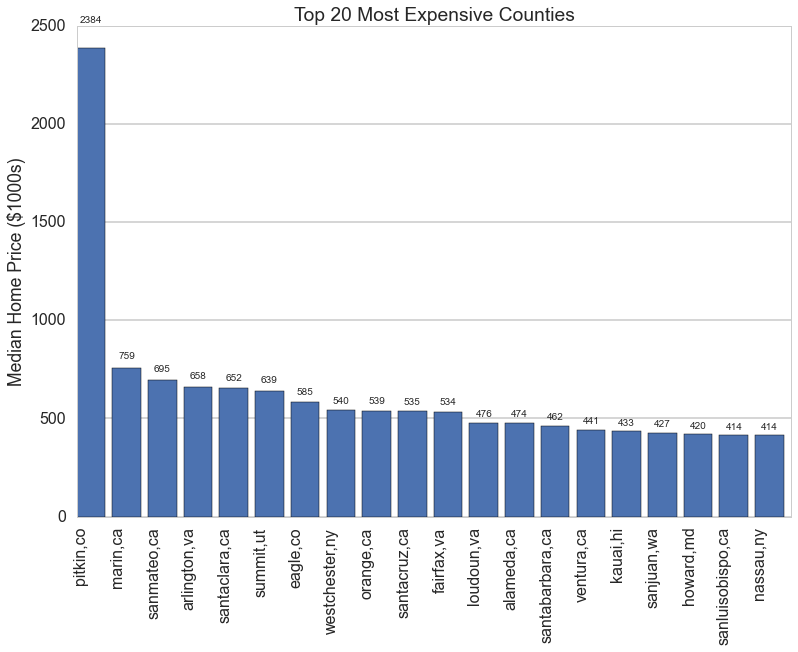

In [22]:
var20 = np.arange(20)
top20 = rankedcounties.head(20)[["Location","Price"]]
fig, ax = plt.subplots()
rect1 = ax.bar(var20,top20["Price"])
ax.set_xticks(var20 + .15)
top20l = np.array(top20["Location"].values)
ax.set_xticklabels(top20l, rotation = "vertical")
ax.set_ylabel("Median Home Price ($1000s)")
ax.set_title("Top 20 Most Expensive Counties")
ax.grid(axis = "x")
autolabel(rect1)
plt.show()

Wow there are some expensive homes in Pitkin, with a median home value more than three times the next most expensvie home! After doing some research, this county is home to both Aspen and Keystone ski resorts.

### Now that we have all of our data cleaned and in a nice dataframe, let's see which features have the strongest effects on price.

/Users/ericrodrigo/anaconda/lib/python2.7/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):
/Users/ericrodrigo/anaconda/lib/python2.7/site-packages/matplotlib/figure.py:1653: UserWarning: This figure includes Axes that are not compatible with tight_layout, so its results might be incorrect.
  warnings.warn("This figure includes Axes that are not "


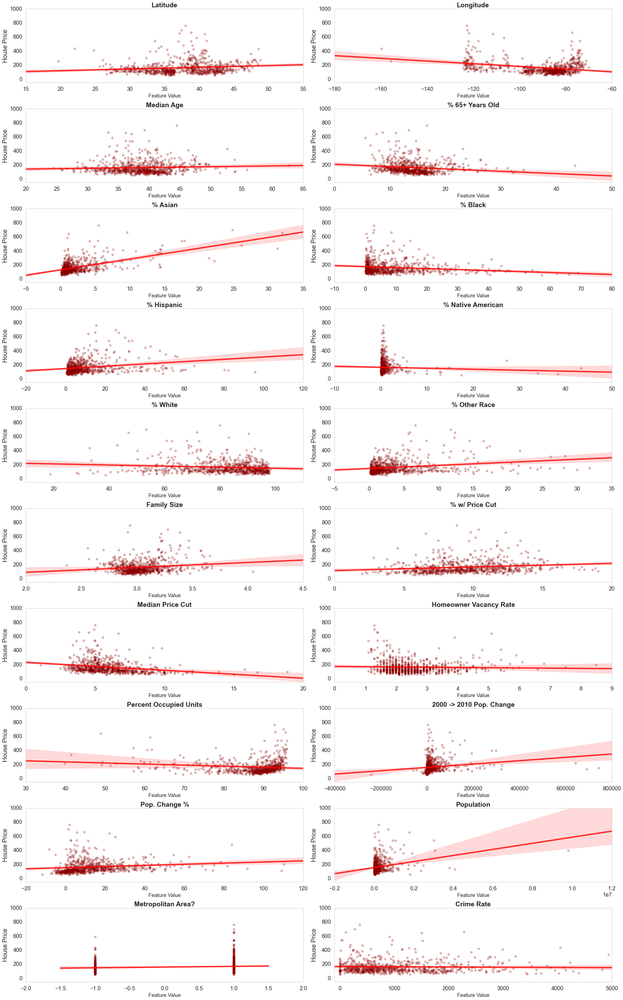

In [13]:
colnames=list(full_2010df.columns)
#colnames.remove('Metropolitan Area?')
colnames.remove('Location')
colnames.remove('Violent Crime Rate')
colnames.remove('Property Crime Rate')
colnames.remove('Price')

#seperate the metropolitan and nonmetropolitan counties so we can see if that has any effect on price
#metro = full_2010df[full_2010df['Metropolitan Area?']==True]
#nonmetro = full_2010df[full_2010df['Metropolitan Area?']==False]

fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(25,40), 
                         tight_layout=True)

for ax, col in zip(axes.ravel(), colnames):
    
    sns.regplot(col,'Price',full_2010df,fit_reg=True,scatter_kws={"color":"darkred","alpha":0.3,"s":50},
                line_kws={"color":"red","alpha":0.8,"lw":4},ax=ax)
    #sns.regplot(col,'Price',nonmetro,fit_reg=True,scatter_kws={"color":"blue","alpha":0.3,"s":50},
                #line_kws={"color":"lightblue","alpha":0.8,"lw":4},ax=ax)

    ax.set_title(col,fontweight='bold')
    ax.set_ylabel('House Price')
    ax.set_xlabel('Feature Value', fontsize = 15)
    ax.grid(False)
    
    #We're going to adjust the y-limit to make the plots a little easier to see, this cuts out one large outlier,
    #Pitkin, CO, which has an average house price of $2.5 million (because the city of Aspen dominates the county)
    ax.set_ylim(-50,1000)
    
    #The Property Crime Rate plot had something funky going on with the x-limit, so this is to adjust that:
    if col == 'Crime Rate':
        ax.set_xlim(-100,5000)
    if col == 'Metropolitan Area?':
        ax.set_xlim(-2,2)

It appears that median age and %65+ have little effect on House Price, as seen by the relatively flat slope of the regression line. 

The regression line for %Asian has a relatively steep upward slope indicating that the higher percentage of Asian, the higher the housing price in the county. Note that while most counties have a low percentage of Asians, the counties that have higher percentages of Asians have notably higher Housing Prices. 

Our regression lines for all the other races are rather flat, indicating overall that race has little effect on housing prices in an area. 

Other Variables such as Crime Rate, Population, Population change also have relatively flat slopes, indicating little relevance towards House Price. 


# Baseline:
#### Using the features included in our dataframe, let's run a basic OLS multiple regression to get coefficients for each of ther features, then use those to predict the prices and we can plot the distribution of the errors. First let's create a mask so we can get test/training data. We'll fit the model on the training data. 

In [58]:
from sklearn.cross_validation import train_test_split
# first create a copy of the entire dataframe
dftouse = full_2010df.copy()
itrain, itest = train_test_split(range(dftouse.shape[0]), train_size=0.7)

mask=np.ones(dftouse.shape[0], dtype='int')
mask[itrain]=1
mask[itest]=0
mask = (mask==1)

In [59]:
woprice = dftouse.drop('Price',1)
woprice = woprice.drop('Location',1)

X_train = woprice[mask]
y_train = dftouse.Price[mask]
X_test = woprice[~mask]
y_test = dftouse.Price[~mask]

In [60]:
from sklearn import linear_model
clf = linear_model.LinearRegression()
clf.fit (X_train,y_train)
coefs = clf.coef_
#Let's check our coefs
coefs

array([  4.42325786e-01,  -1.43932156e+00,   1.40591348e+01,
        -1.89460746e+01,   2.95861336e+01,   1.06547218e+01,
         8.34239123e-01,   9.57627026e+00,   1.10851586e+01,
         1.27538363e+01,  -8.07432569e+01,   6.62163356e-01,
        -6.82997376e+00,  -1.84321222e+01,  -5.73241481e+00,
        -2.07153639e-04,   7.95952763e-01,   2.87235120e-05,
        -4.01888222e-03,   3.45140395e-03,   1.16029275e+00,
        -5.67478295e-04])

Average error ($1000s): 8.022
Train Score: 0.37
Test Score: 0.31


/Users/aharding/anaconda/lib/python3.5/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


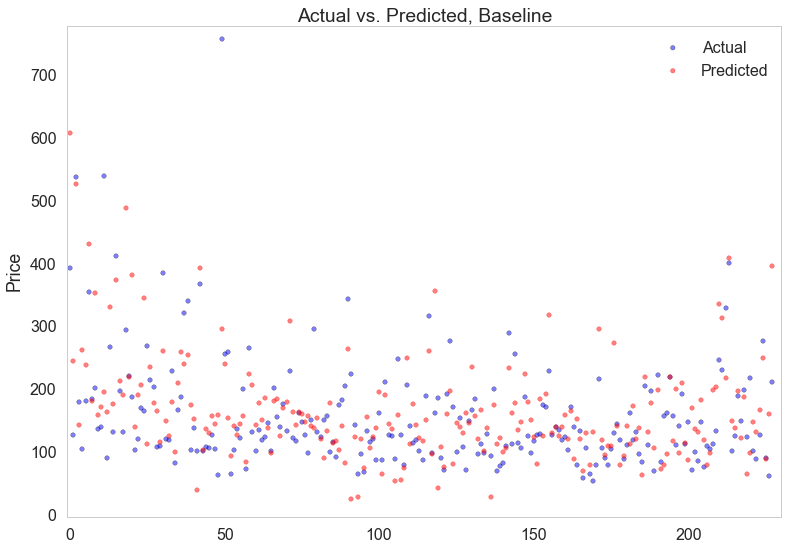

In [61]:
#Now we calculate the average error to see how far off we are
preds = clf.predict(X_test)
errors = preds - y_test
print("Average error ($1000s): %.3f"% np.mean(errors))
print('Train Score: %0.2f'%clf.score(X_train,y_train))
print('Test Score: %0.2f'%clf.score(X_test,y_test))

#Let's also plot the actual vs predicted values

count = [x for x in range(0,len(y_test),1)]
plt.scatter(count,y_test,alpha=0.5)
plt.scatter(count,preds,color='r',alpha=0.5)
plt.xlim(-1,230)
plt.ylim(-1,780)
plt.title("Actual vs. Predicted, Baseline")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

#### As we can see, most of the predictions lie very close to their corresponding actual values, and with an average error typically less than $10,000 we've actually done fairly well! Or have we? Let's check the standard deviation. 

Standard deviation of errors ($1000s): 72.739


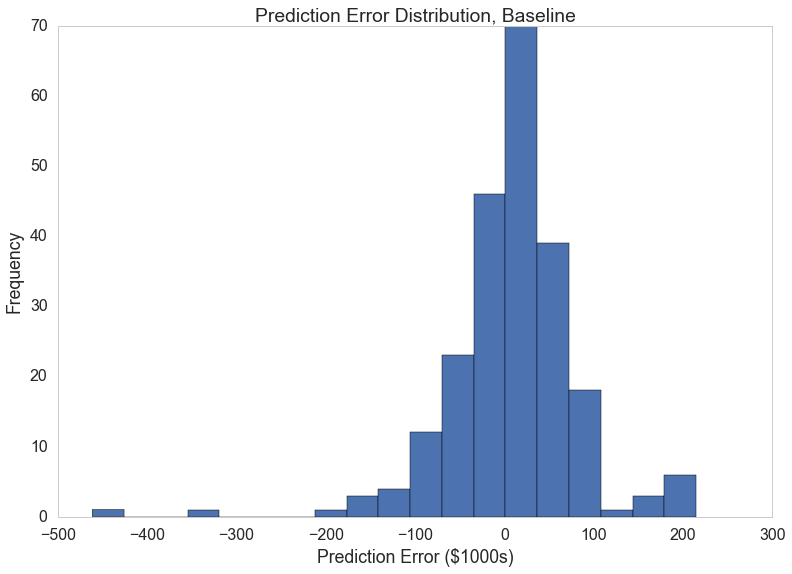

In [149]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(errors))
plt.hist(errors.values,bins=19)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Baseline')

Yikes! Even though on average we weren't very far off the true price, it looks like we have a lot of room to improve on the standard deviation of our errors. If we assume our errors are normally distributed (not that wild of an assumption in this situation) then that means 30+% of our predictions are off by over $65,000 (depending on the testing and the training set this number varies). Let's see what we can do to fix that. However, standard deviation is largely affected by outliers, and considering housing prices tend to be largely skewed to the left, a standard deviation of around 65,000 is actually quite good.

Maybe our model should be non-linear. Lets create a Residuals plot to see if our residuals are randomly distributed around zero, which indicates that our model should be linear

/Users/aharding/anaconda/lib/python3.5/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


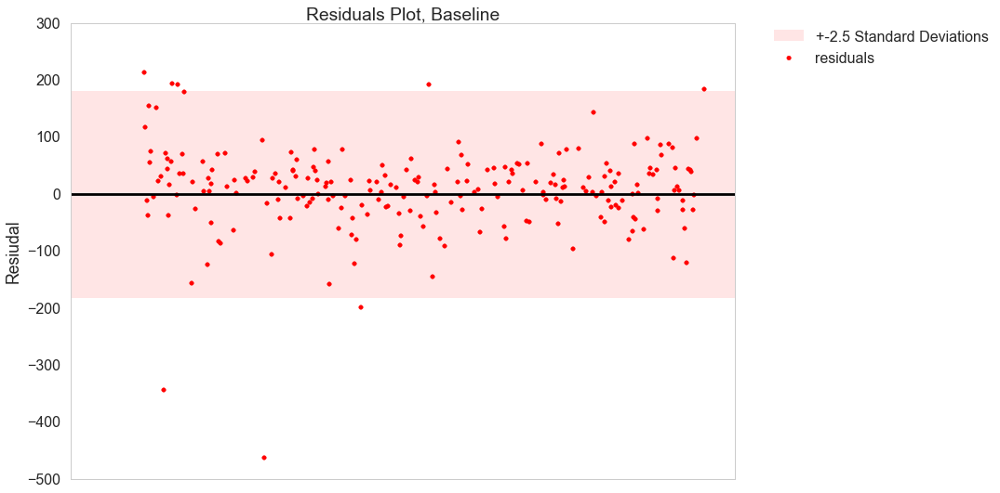

In [95]:
plt.scatter(errors.index,errors.values, color = "red", label = "residuals")
plt.grid(None)
plt.axhline(0, color = "black")
plt.axhspan(np.std(errors)*2.5, -np.std(errors)*2.5, color='r', alpha=0.1, lw=0, label = "+-2.5 Standard Deviations")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Residuals Plot, Baseline")
plt.ylabel("Resiudal")
plt.xticks([])
plt.show()

The errors appear to be fairly randomly distributed around 0, indicating a good fit for a linear model. We can see the outliers that seem to be hurting our model. 

Out of curiousity, let's check what counties the outliers are from:

In [93]:
for x in errors.index:
    if errors[x] <-np.std(errors)*2.5:
        culprit = full_2010df.iloc[x]
        print("--County:",culprit.Location,"--Median Price:",culprit.Price, "--Error:",errors[x])
        print('\n')
for x in errors.index:
    if errors[x] > np.std(errors*2.5):
        culprit = full_2010df.iloc[x]
        print("--County:",culprit.Location,"--Median Price:",culprit.Price, "--Error:",errors[x])
        print('\n')


--County: westchester,ny --Median Price: 540.2 --Error: -342.904256962


--County: marin,ca --Median Price: 759.1 --Error: -461.723893037


--County: washington,ut --Median Price: 225.6 --Error: -197.926176311


--County: losangeles,ca --Median Price: 394.5 --Error: 214.638080484


--County: middlesex,nj --Median Price: 295.0 --Error: 194.287398062


--County: collin,tx --Median Price: 189.6 --Error: 192.907260845


--County: sutter,ca --Median Price: 163.5 --Error: 193.629850213


--County: clearcreek,co --Median Price: 213.5 --Error: 184.69900058




Interesting how almost all of these cities are in the West or in the Northeast. Lets explore this observation more later.

How about we try something that we're already familiar with from a past pset? The LinearSVM.

We actually can't because our features have continuous values and LinearSVC expects binary indicators, but we found that out after we wrote all of the code. I guess we'll have to think of something else. 

In [414]:
from sklearn.svm import LinearSVC
#Create our classifier
clfsvm=LinearSVC(C=1.0,loss="hinge")
#Cs=[0.01, 0.1, 1.0, 10.0]
Xmatrix=woprice
Yprice=dftouse.Price
#Create our test and train sets for this model
Xmatrix_train=Xmatrix[mask]
Yprice_train=Yprice[mask]
Xmatrix_test=Xmatrix[~mask]
Yprice_test=Yprice[~mask]

In [415]:
#Use gridsearch to pin down the best value of C
#from sklearn.grid_search import GridSearchCV
#inst = GridSearchCV(clfsvm, param_grid={"C": Cs}, cv=5, n_jobs=2)
#inst.fit(Xmatrix, Yprice)
#print "BEST", inst.best_params_, inst.best_score_, inst.grid_scores_
#best = inst.best_estimator_

In [416]:
'''
clfsvm = clfsvm.fit(Xmatrix_train, Yprice_train)
svmtrain_acc = clfsvm.score(Xmatrix_train, Yprice_train)
svmtest_acc = clfsvm.score(Xmatrix_test, Yprice_test)
svmpreds = slfsvm.predict(Xmatrix_test)
svmerrors = svmpreds - Yresp_test
print("Average error ($1000s): %.3f"% np.mean(svmerrors))

print "Accuracy on training data: %0.2f" %svmtrain_acc
print "Accuracy on test data:     %0.2f" %svmtest_acc
'''

'\nclfsvm = clfsvm.fit(Xmatrix_train, Yprice_train)\nsvmtrain_acc = clfsvm.score(Xmatrix_train, Yprice_train)\nsvmtest_acc = clfsvm.score(Xmatrix_test, Yprice_test)\nsvmpreds = slfsvm.predict(Xmatrix_test)\nsvmerrors = svmpreds - Yresp_test\nprint("Average error ($1000s): %.3f"% np.mean(svmerrors))\n\nprint "Accuracy on training data: %0.2f" %svmtrain_acc\nprint "Accuracy on test data:     %0.2f" %svmtest_acc\n'

# Ridge Regression

In [417]:
als = [.01,.1,1.,5.,10.,15.,20.]
scores1 = []
for a in als:
    ridgeclf = linear_model.Ridge (alpha = a)
    ridgeclf.fit (X_train,y_train) 
    score = ridgeclf.score(X_test,y_test)
    scores1.append(score)
scores1
#15. gives us the best result

[0.49001336910293825,
 0.49062247918806634,
 0.49499031636574053,
 0.50117945631543537,
 0.50270453607813859,
 0.50298632716122371,
 0.50288958082507562]

Average error ($1000s): 3.090
Train Score: 0.31
Test Score: 0.50


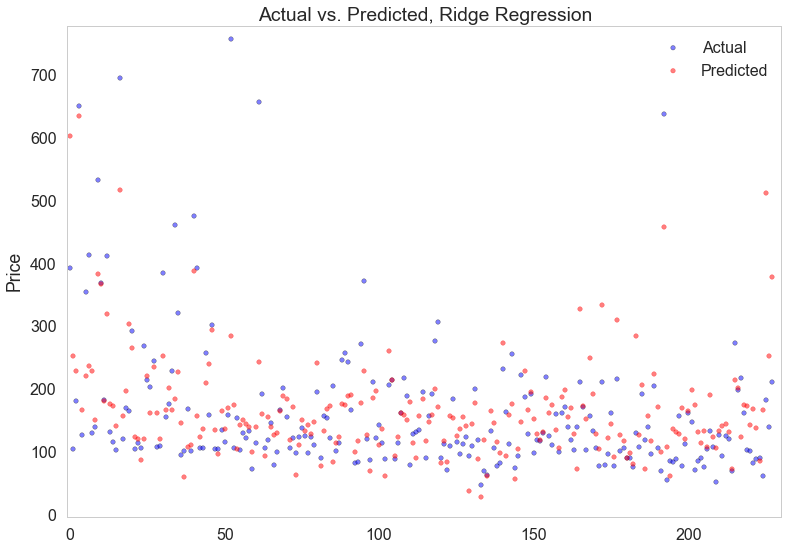

In [418]:
ridgeclf = linear_model.Ridge (alpha = 15.)
ridgeclf.fit (X_train,y_train) 
ridgepreds = ridgeclf.predict(X_test)
ridgeerrors = ridgepreds - y_test
print("Average error ($1000s): %.3f"% np.mean(ridgeerrors))
print('Train Score: %0.2f'%ridgeclf.score(X_train,y_train))
print('Test Score: %0.2f'%ridgeclf.score(X_test,y_test))

#Let's also plot the actual vs predicted values
plt.scatter(count,y_test,alpha=0.5)
plt.scatter(count,ridgepreds,color='r',alpha=0.5)
plt.xlim(-1,230)
plt.ylim(-1,780)
plt.title("Actual vs. Predicted, Ridge Regression")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

Standard deviation of errors ($1000s): 78.561


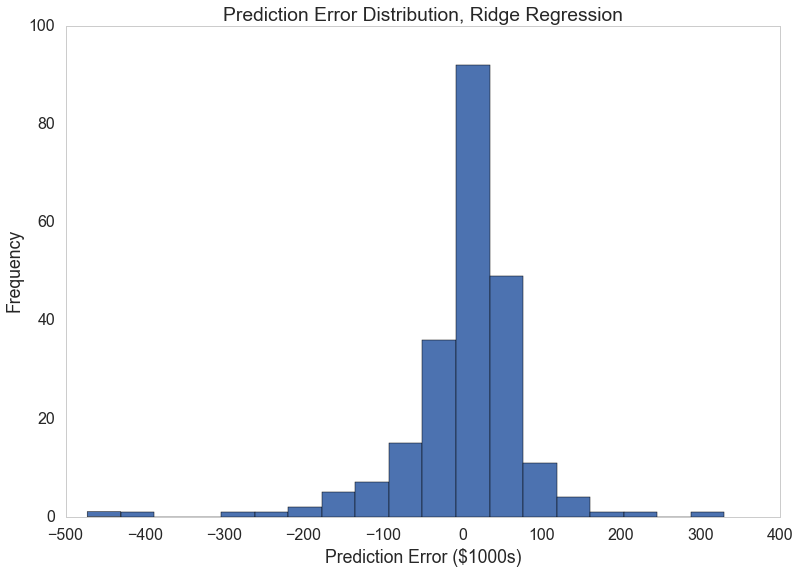

In [419]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(ridgeerrors))
plt.hist(ridgeerrors.values,bins=19)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Ridge Regression')

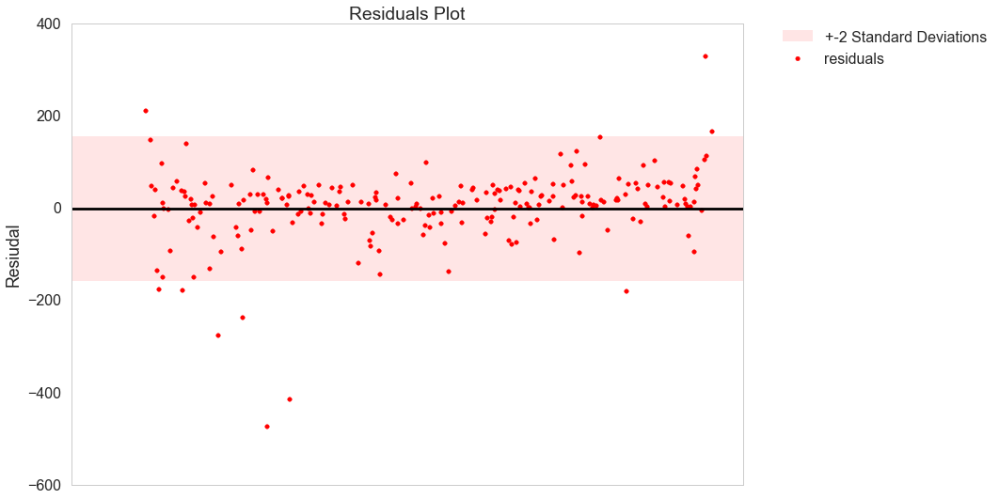

In [420]:
plt.scatter(ridgeerrors.index,ridgeerrors.values, color = "red", label = "residuals")
plt.grid(None)
plt.axhline(0, color = "black")
plt.axhspan(np.std(ridgeerrors)*2, -np.std(ridgeerrors)*2, color='r', alpha=0.1, lw=0, label = "+-2 Standard Deviations")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title("Residuals Plot")
plt.ylabel("Resiudal")
plt.xticks([])
plt.show()

Again, the errors appear to be randomly distributed around 0, indicating a good fit for a linear model. We can see the outliers that seem to be hurting our model. 

Well that's not much better, the same accuracy on the train data and only slightly better on the test data... This is probably because Ridge Regression is identical to OLS except that it penalizes large coefficients. However, we don't have any massive coefficients, so there isn't a whole lot of penalizing going on. 

# Lasso Method

In [421]:
scores2 = []
for a in als:
    lassoclf = linear_model.Lasso(alpha = a)
    lassoclf.fit(X_train,y_train)
    score = lassoclf.score(X_test,y_test)
    scores2.append(score)
scores2
#1. gave us our best results

[0.49022487607850807,
 0.49261907046125353,
 0.50146217722487074,
 0.48455216360223052,
 0.47056359254012259,
 0.45607255722804008,
 0.43515258757999464]

Average error ($1000s): 2.794
Train Score: 0.31
Test Score: 0.50


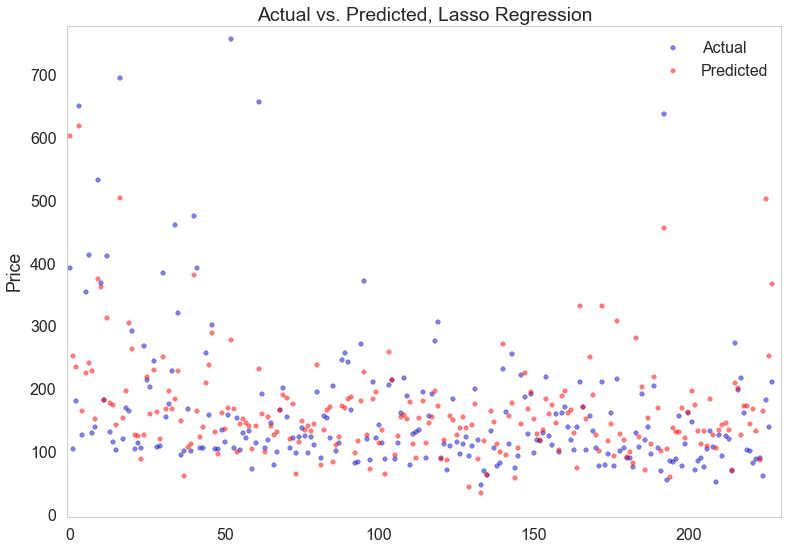

In [422]:
lassoclf = linear_model.Lasso(alpha = 1.)
lassoclf.fit(X_train,y_train)
lassopreds = lassoclf.predict(X_test)
lassoerrors = lassopreds - y_test
print("Average error ($1000s): %.3f"% np.mean(lassoerrors))
print('Train Score: %0.2f'%lassoclf.score(X_train,y_train))
print('Test Score: %0.2f'%lassoclf.score(X_test,y_test))

#Let's also plot the actual vs predicted values
plt.scatter(count,y_test,alpha=0.5)
plt.scatter(count,lassopreds,color='r',alpha=0.5)
plt.xlim(-1,230)
plt.ylim(-1,780)
plt.title("Actual vs. Predicted, Lasso Regression")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

Standard deviation of errors ($1000s): 78.693


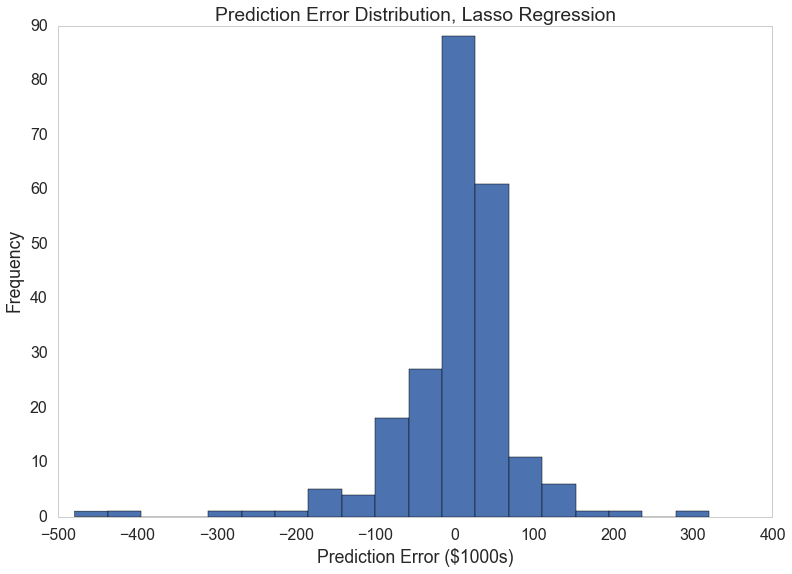

In [423]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(lassoerrors))
plt.hist(lassoerrors.values,bins=19)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Lasso Regression')

Once again this is about the same as the others, slightly worse than ridge regression. How about a Lars Lasso (Least Angle Regression Lasso), "estimated parameters are increased in a direction equiangular to each one's correlations with the residual" - https://en.wikipedia.org/wiki/Least-angle_regression

# Lars-Lasso

Average error ($1000s): 2.794
Train Score: 0.29
Test Score: 0.50


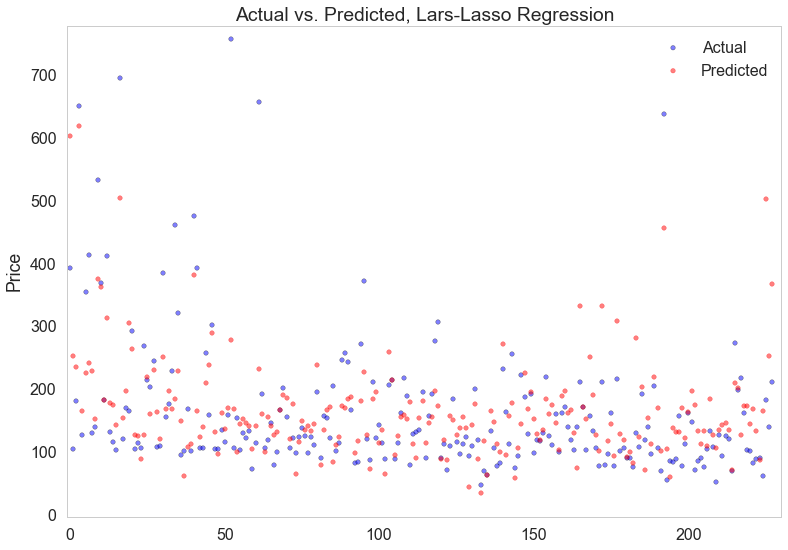

In [424]:
larsclf = linear_model.LassoLars(alpha = .1)
larsclf.fit(X_train,y_train)
larspreds = lassoclf.predict(X_test)
larserrors = larspreds - y_test
print("Average error ($1000s): %.3f"% np.mean(larserrors))
print('Train Score: %0.2f'%larsclf.score(X_train,y_train))
print('Test Score: %0.2f'%larsclf.score(X_test,y_test))

#Let's also plot the actual vs predicted values
plt.scatter(count,y_test,alpha=0.5)
plt.scatter(count,larspreds,color='r',alpha=0.5)
plt.xlim(-1,230)
plt.ylim(-1,780)
plt.title("Actual vs. Predicted, Lars-Lasso Regression")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

Standard deviation of errors ($1000s): 78.693


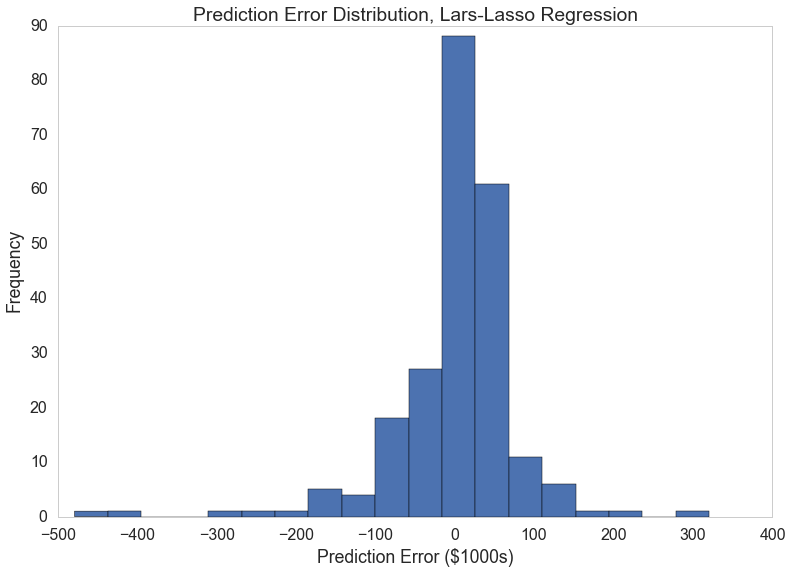

In [425]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(larserrors))
plt.hist(larserrors.values,bins=19)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Lars-Lasso Regression')

Looking at the scatter plot for this regression model it looks like we achieved the best spread so far (i.e. covered the outliers best). However, our standard deviation is about the same as our other top models so far, as is the average error and both our training and test scores. We still haven't found a clear winner, so we'll keep trying, venturing out into methods we didn't use in labs/HW.  

# Elastic Net w/ Cross Validation

In [426]:
folds = [x for x in range(2,502,20)]
scores3 = []
for fold in folds:
    elasticclf = linear_model.ElasticNetCV(cv=fold)
    elasticclf.fit(X_train,y_train)
    score = elasticclf.score(X_test,y_test)
    scores3.append(score)
scores3
#1. gave us our best results

[0.075133746814854074,
 0.074581000662495178,
 0.073667487844445656,
 0.070988719777747011,
 0.074125361694863168,
 0.072636078133275106,
 0.073376594776984438,
 0.074303546969068268,
 0.074581000662495178,
 0.06938753910947959,
 0.070988719777747011,
 0.07162418767698564,
 0.07162418767698564,
 0.072636078133275106,
 0.06938753910947959,
 0.070248621199956007,
 0.072169207736920038,
 0.072636078133275106,
 0.072636078133275106,
 0.073035460365680982,
 0.073376594776984438,
 0.073667487844445656,
 0.073915074929874147,
 0.073915074929874147,
 0.073915074929874147]

Average error ($1000s): -0.889
Train Score: 0.02
Test Score: 0.08


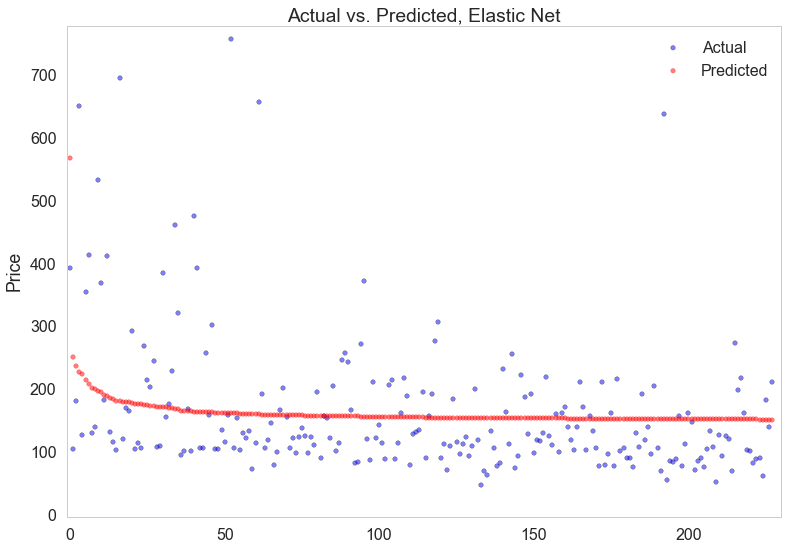

In [427]:
elasticclf = linear_model.ElasticNetCV(cv=2)
elasticclf.fit(X_train,y_train)
elasticpreds = elasticclf.predict(X_test)
elasticerrors = elasticpreds - y_test
print("Average error ($1000s): %.3f"% np.mean(elasticerrors))
print('Train Score: %0.2f'%elasticclf.score(X_train,y_train))
print('Test Score: %0.2f'%elasticclf.score(X_test,y_test))

#Let's also plot the actual vs predicted values
plt.scatter(count,y_test,alpha=0.5)
plt.scatter(count,elasticpreds,color='r',alpha=0.5)
plt.xlim(-1,230)
plt.ylim(-1,780)
plt.title("Actual vs. Predicted, Elastic Net")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

Standard deviation of errors ($1000s): 107.246


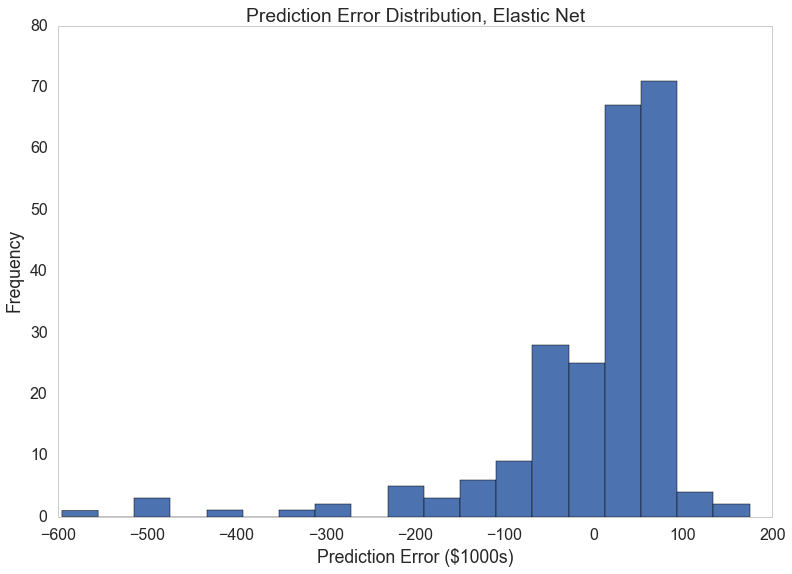

In [428]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(elasticerrors))
plt.hist(elasticerrors.values,bins=19)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Elastic Net')

*OOOOF!* That's... not great. But it is interesting! We tended to overestimate for each location. The strong leftward skew of the histogram backs this up. Lets quickly explore this.

In [429]:
overestimates = 0 
for x in elasticerrors:
    if x > 0:
        overestimates += 1.
print("Percentage of Elastic-Net Etimates that were Over-estimates:", overestimates/len(elasticerrors))

('Percentage of Elastic-Net Etimates that were Over-estimates:', 0.6710526315789473)


So Elastic Net has one of the closest averages (again, depends on the mask), but an extremely large variance. The scatter plot almost looks like a moving average plot, which would similarily do a good job of getting the overall average, but at the cost of a larger standard deviation amongst the errors.

# K-Nearest Neighbors
Recall that the K-Nearest method finds the k most similar counties from a the training dataset for each county in the test set. 

We'll first need to normalize the data so that catagories with high values don't swing the distance more than lower value catagories. 

In [430]:
#Let's first list all the columns that are integers or floats and can be standardized:
PERCENT_VARS = ['% 65+ Years Old','% Asian','% Black','% Hispanic','% Native American','% White','% Other Race','% w/ Price Cut','Homeowner Vacancy Rate','Percent Occupied Units','Pop. Change %']
STANDARDIZABLE = PERCENT_VARS  + ['Latitude','Longitude','Median Age','Family Size','Median Price Cut','2000 -> 2010 Pop. Change','Population','Violent Crime Rate','Property Crime Rate']
INDICATOR_VAR = ['Metropolitan Area?']

#Let's standardize the data for both the test and training sets:
from sklearn.preprocessing import StandardScaler

# separate out training part of dataset
train = dftouse[mask]

# from http://sebastianraschka.com/Articles/2014_about_feature_scaling.html
# get standardization for training and testing sets
std_scale = StandardScaler().fit(train[STANDARDIZABLE])

# transform training and test parts of each col
stand_array = std_scale.transform(dftouse[STANDARDIZABLE], copy=False)

#create dftousestd with this data
dftousestd = dftouse
dftousestd[STANDARDIZABLE] = pd.DataFrame(data=stand_array, columns=STANDARDIZABLE)
dftousestd.head()

,Location,Price,Latitude,Longitude,Median Age,% 65+ Years Old,% Asian,% Black,% Hispanic,% Native American,% White,% Other Race,Family Size,% w/ Price Cut,Median Price Cut,Homeowner Vacancy Rate,Percent Occupied Units,2000 -> 2010 Pop. Change,Pop. Change %,Population,Violent Crime Rate,Property Crime Rate,Metropolitan Area?,Crime Rate
0,"losangeles,ca",394.5,-0.798089,-1.809665,-0.856044,-0.799578,3.686894,-0.016338,3.258185,-0.102279,-2.360872,3.995393,2.990666,0.936590,-0.496197,-0.926255,0.846273,4.181129,-0.695026,23.694431,-0.341469,-0.961815,1,242.468253
1,"harris,tx",128.4,-1.584336,-0.294024,-1.409973,-1.472716,1.293196,0.921808,2.665054,-0.102279,-1.886669,2.338915,2.162807,0.799297,-0.751779,-0.295176,0.323387,10.162796,0.399109,9.559112,0.699943,0.551751,1,1562.141490
2,"maricopa,az",148.3,-0.894017,-1.399835,-0.898654,-0.511090,0.431465,-0.356645,1.702289,0.382618,-0.652235,2.007619,1.169377,3.247291,-0.258401,1.598062,-0.126539,10.971603,0.647197,8.879415,-0.660347,-1.015628,1,159.963658
3,"sandiego,ca",393.6,-0.969351,-1.721659,-0.898654,-0.679374,2.793247,-0.347448,1.908596,-0.033008,-1.329668,2.184310,1.500520,1.839339,-0.711899,-0.715895,0.748992,3.910135,-0.256100,7.097600,-0.499138,-0.940085,1,239.620355
4,"orange,ca",539.2,-0.830885,-1.775340,-0.557774,-0.631293,5.027364,-0.660163,2.054730,-0.136914,-1.570533,2.383087,2.383570,1.381175,-0.900868,-1.241795,0.907074,2.119401,-0.523273,6.887573,-0.816358,-1.132437,1,48.567685


Average error ($1000s): -4.900
Train Score: 0.14
Test Score: -0.04


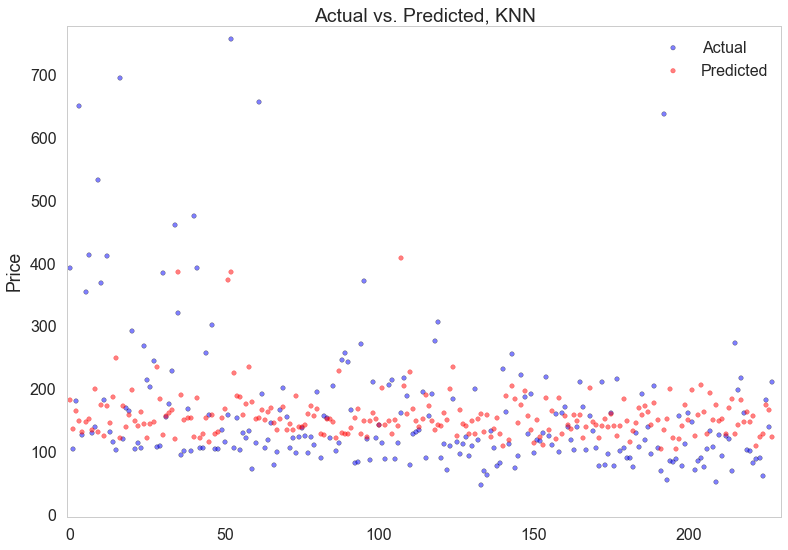

In [431]:
from sklearn.neighbors import KNeighborsRegressor
usable = dftousestd.drop('Price',1)
usable = usable.drop('Location',1)
targetdf = usable[~mask]
targetactual = dftousestd[~mask].Price.values
knownstd = usable[mask]
known = dftousestd[mask].Price
k = 10

knn = KNeighborsRegressor(n_neighbors=k)
knn.fit(knownstd, known)
knnpreds = knn.predict(targetdf)
knnerrors = knnpreds - targetactual
print("Average error ($1000s): %.3f"% np.mean(knnerrors))
print('Train Score: %0.2f'%knn.score(knownstd,known))
print('Test Score: %0.2f'%knn.score(targetdf,targetactual))

#Let's also plot the actual vs predicted values
plt.scatter(count,targetactual,alpha=0.5)
plt.scatter(count,knnpreds,color='r',alpha=0.5)
plt.xlim(-1,230)
plt.ylim(-1,780)
plt.title("Actual vs. Predicted, KNN")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

Standard deviation of errors ($1000s): 113.875


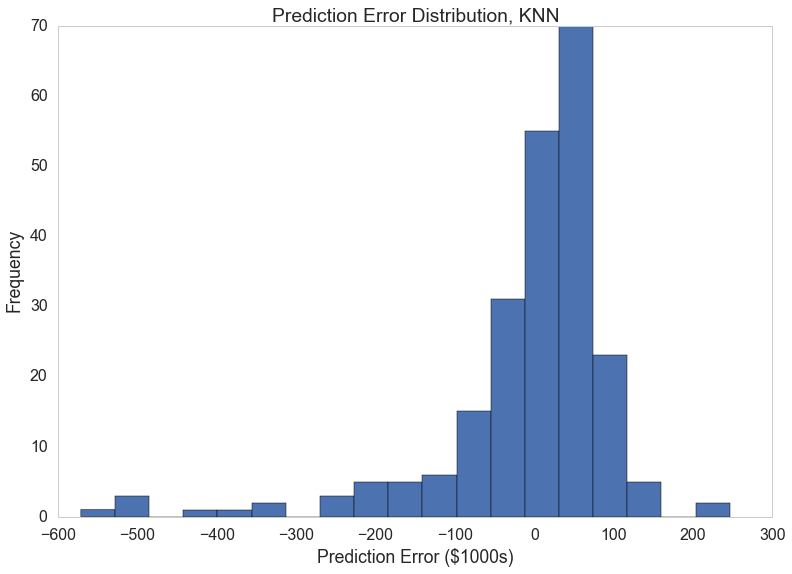

In [432]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(knnerrors))
plt.hist(knnerrors,bins=19)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, KNN')

Hmmm... It seems we get a fairly tight average error, but the  largest standard deviation so far. We thought KNN would work much better than this, could it be that our data is too diverse to properly take advantage of KNN? Using more neighbors to estimate means that we'll get closer to the correct value for the counties closer to the mean, but be off by more for counties that lie further from the mean. We can see this in the scatter plot from the higher accuracy with lower priced counties (i.e. closer to the mean of all counties), and large innaccuracies for high-priced counties. You can try this out yourself, as k increases the predicted dots get more and more linear. Fiddling with the value for k we can see that as k increases the histogram of errors gets taller around zero, but the tail also goes out further, raising our standard deviation. Is there a way to dull this effect?

# Random Forest
We've heard this dozens of times in lecture and lab, but never implemented it ourselves or really seen what it can do, let's try it out and see if it will give us definitive results.

Average error ($1000s): -2.519
Train Score: 0.80
Test Score: 0.65


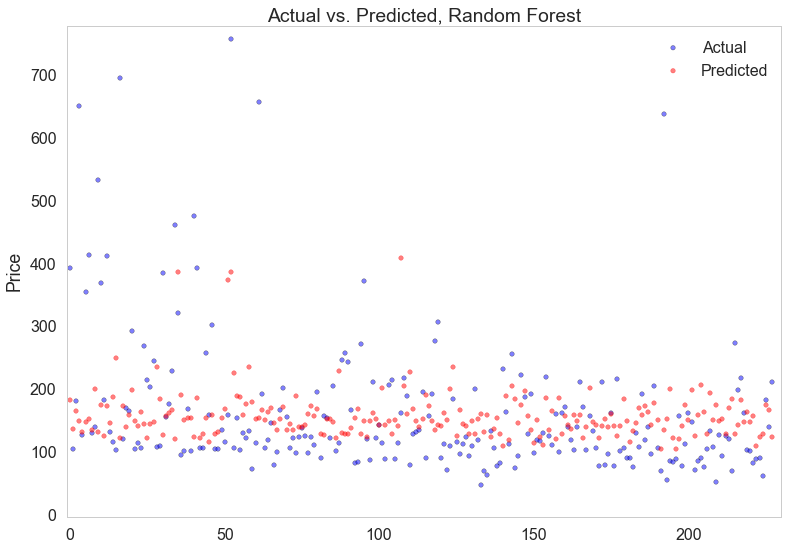

In [448]:
from sklearn import ensemble
#Try to find an omptimal number of trees
'''
forestscores = []
for x in range(1,101,2):
    forest = ensemble.RandomForestRegressor(n_estimators=x)
    forest.fit(knownstd, known)
    score = forest.score(targetdf,targetactual)
    forestscores.append(score)

trees = forestscores.index(max(forestscores))*2 + 1
print("Optimal Number of Trees = ", trees)
'''
#The optimal number of trees changes each time you set up the regressor, so we'll just go with an approximation. 

forest = ensemble.RandomForestRegressor(n_estimators=25)
forest.fit(knownstd, known)
forestpreds = forest.predict(targetdf)
foresterrors = forestpreds - targetactual
print("Average error ($1000s): %.3f"% np.mean(foresterrors))
print('Train Score: %0.2f'%forest.score(knownstd,known))
print('Test Score: %0.2f'%forest.score(targetdf,targetactual))

#Let's also plot the actual vs predicted values
plt.scatter(count,targetactual,alpha=0.5)
plt.scatter(count,knnpreds,color='r',alpha=0.5)
plt.xlim(-1,230)
plt.ylim(-1,780)
plt.title("Actual vs. Predicted, Random Forest")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)


Standard deviation of Random Forest errors ($1000s): 66.287
Standard deviation of Baseline errors ($1000s): 79.586


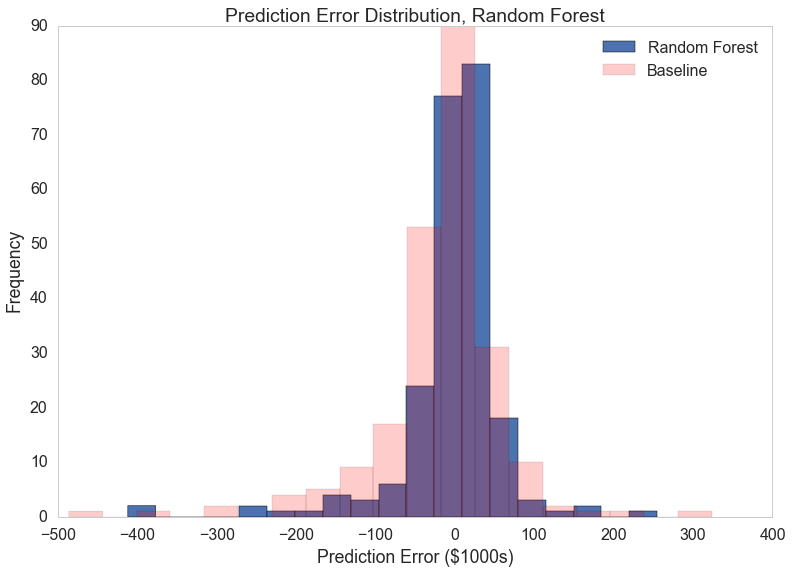

In [449]:
print("Standard deviation of Random Forest errors ($1000s): %.3f"% np.std(foresterrors))
print("Standard deviation of Baseline errors ($1000s): %.3f"%np.std(errors))

plt.hist(foresterrors,bins=19)
plt.hist(errors.values,bins=19,alpha = 0.2, color='r',align='left')
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Random Forest')
plt.legend(['Random Forest','Baseline'])

Finally, a method that really stands out! Not only do we have a test accuracy .15* greater than our best previous method, but the standard deviation has dropped by ~$10,000. This is also the most normal distribution of errors we have had so far, which suggests the random forest method is fairly evenly guessing over/under the true price. This makes sense because it is an ensemble method, meaning it combines several different methods for estimation. We will check below. 

*The test accuracy fluctuates every time we re-run the regressor, but it usually around .65, compared to .50 for Ridge Regression and the Lasso methods 

In [450]:
overestimates = 0 
for x in foresterrors:
    if x > 0:
        overestimates += 1.
print("Percentage of Random Forest Etimates that were Over-estimates:", overestimates/len(knnerrors))

('Percentage of Random Forest Etimates that were Over-estimates:', 0.5964912280701754)


It wasn't as close to even as it first appeared, but the Random Forest Regression still does the best job by far in terms of both accuracy and standard deviation. 

# Analysis by Region
####  **It became apparent to us that a lot of variation in our data set was likely due to differences in prices against regions. So we are going to split our dataframes into 5 major regions: Northeast,Southeast,Midwest,Southwest,and West. Like so:**
<img src="us-map.png">

In [23]:
#Split up by region
W = ["ca","or","wa","nv","id","ut","co","wy","mt"]
W_counties = []
for x in rankedcounties["Location"]:
    if x[-2:] in W:
        W_counties.append(x)
Wdf = rankedcounties[rankedcounties["Location"].isin(W_counties)]
print("Number of counties analyzed in the West: ",len(Wdf))

NE = ["md","de","pa","nj","ct","ny","ri","ma","nh","vt","me"]
NE_counties = []
for x in rankedcounties["Location"]:
    if x[-2:] in NE:
        NE_counties.append(x)
NEdf = rankedcounties[rankedcounties["Location"].isin(NE_counties)]
print("Number of counties analyzed in the North-East: ",len(NEdf))

SE = ["la","ar","ms","al","ga","sc","nc","va","wv","ky","tn","fl"]
SE_counties = []
for x in rankedcounties["Location"]:
    if x[-2:] in SE:
        SE_counties.append(x)
# rankedcounties = rankedcounties[rankedcounties["Location"] != "arlington,va"]
# rankedcounties = rankedcounties[rankedcounties["Location"] != "fairfax,va"]
SEdf = rankedcounties[rankedcounties["Location"].isin(SE_counties)]
print("Number of counties analyzed in the South-East: ",len(SEdf))


MW = ["nd","sd","ne","ks","mn","ia","mo","wi","il","in","mi","oh"]
MW_counties = []
for x in rankedcounties["Location"]:
    if x[-2:] in MW:
        MW_counties.append(x)
MWdf = rankedcounties[rankedcounties["Location"].isin(MW_counties)]
print("Number of counties analyzed in the Mid-West: ",len(MWdf))

SW = ["az","nm","tx","ok"]
SW_counties = []
for x in rankedcounties["Location"]:
    if x[-2:] in SW:
        SW_counties.append(x)
SWdf = rankedcounties[rankedcounties["Location"].isin(SW_counties)]
print("Number of counties analyzed in the South-West: ",len(SWdf))
print("Total number of counties analyzed in this Dataset", len(rankedcounties))

('Number of counties analyzed in the West: ', 127)
('Number of counties analyzed in the North-East: ', 110)
('Number of counties analyzed in the South-East: ', 276)
('Number of counties analyzed in the Mid-West: ', 167)
('Number of counties analyzed in the South-West: ', 78)
('Total number of counties analyzed in this Dataset', 760)


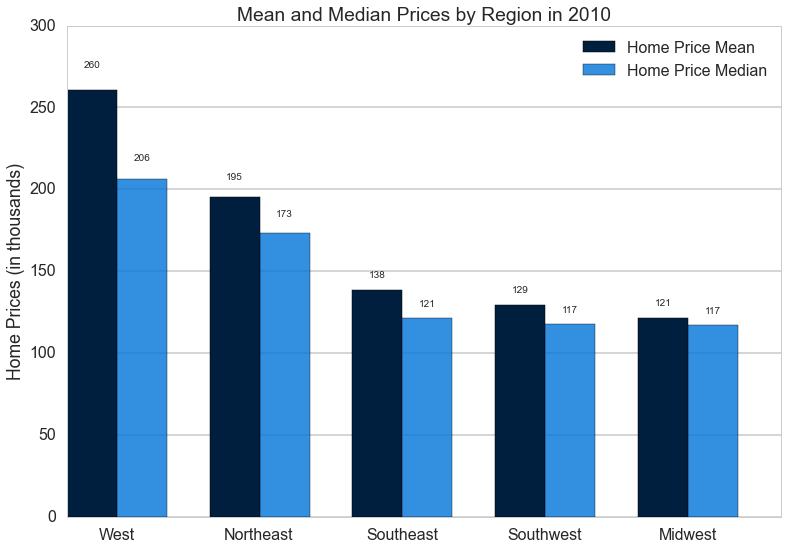

In [24]:
#!/usr/bin/env python
# a bar plot with errorbars
import numpy as np
import matplotlib.pyplot as plt

N = 5
Means = (Wdf.Price.mean(), NEdf.Price.mean(), SEdf.Price.mean(), SWdf.Price.mean(), MWdf.Price.mean())

ind = np.arange(N)  # the x locations for the groups
width = 0.35       # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(ind, Means, width, color='#001f3f')

Medians = (Wdf.Price.median(), NEdf.Price.median(), SEdf.Price.median(), SWdf.Price.median(), MWdf.Price.median())
rects2 = ax.bar(ind + width, Medians, width, color='#0074D9',alpha = .8)

# add some text for labels, title and axes ticks
ax.set_ylabel('Home Prices (in thousands)')
ax.set_title('Mean and Median Prices by Region in 2010')
ax.set_xticks(ind + width)
ax.set_xticklabels(("West", "Northeast", "Southeast", "Southwest", "Midwest"))

ax.legend((rects1[0], rects2[0]), ('Home Price Mean', 'Home Price Median'))

autolabel(rects1)
autolabel(rects2)

plt.grid(axis = "x")
plt.show()

Wow, as we suspected there is a pretty huge difference in the mean price between the 5 regions! The average home value of the W is nearly double that of the Midwest,SouthEast,and SouthWest! However, the mean is affected by highly priced outliers, so we plotted the median as well. Still, the West and the Northeast dominate the field in 2010. Lets see if these differences are consistent over the past 19 years.

In [25]:
county_pricesint = county_prices.copy()
county_pricesint.columns = [1996,1997,1998,
                         1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,"Location"]

W_time = []
for x in county_pricesint["Location"]:
    if x[-2:] in W:
        W_time.append(x)
Wdf_time = county_pricesint[county_pricesint["Location"].isin(W_time)]

SW_time = []
for x in county_pricesint["Location"]:
    if x[-2:] in SW:
        SW_time.append(x)
SWdf_time = county_pricesint[county_pricesint["Location"].isin(SW_time)]

NE_time = []
for x in county_pricesint["Location"]:
    if x[-2:] in NE:
        NE_time.append(x)
NEdf_time = county_pricesint[county_pricesint["Location"].isin(NE_time)]

SE_time = []
for x in county_pricesint["Location"]:
    if x[-2:] in SE:
        SE_time.append(x)
SEdf_time = county_pricesint[county_pricesint["Location"].isin(SE_time)]

MW_time = []
for x in county_pricesint["Location"]:
    if x[-2:] in MW:
        MW_time.append(x)
MWdf_time = county_pricesint[county_pricesint["Location"].isin(MW_time)]

print("Number of counties analyzed in the South-West: ",len(SWdf_time))
print("Number of counties analyzed in the West: ",len(Wdf_time))
print("Number of counties analyzed in the Mid-West: ",len(MWdf_time))
print("Number of counties analyzed in the North-East: ",len(NEdf_time))
print("Number of counties analyzed in the South-East: ",len(SEdf_time))
print("Number of counties analyzed Total: ",len(county_prices))

('Number of counties analyzed in the South-West: ', 66)
('Number of counties analyzed in the West: ', 131)
('Number of counties analyzed in the Mid-West: ', 211)
('Number of counties analyzed in the North-East: ', 157)
('Number of counties analyzed in the South-East: ', 338)
('Number of counties analyzed Total: ', 907)


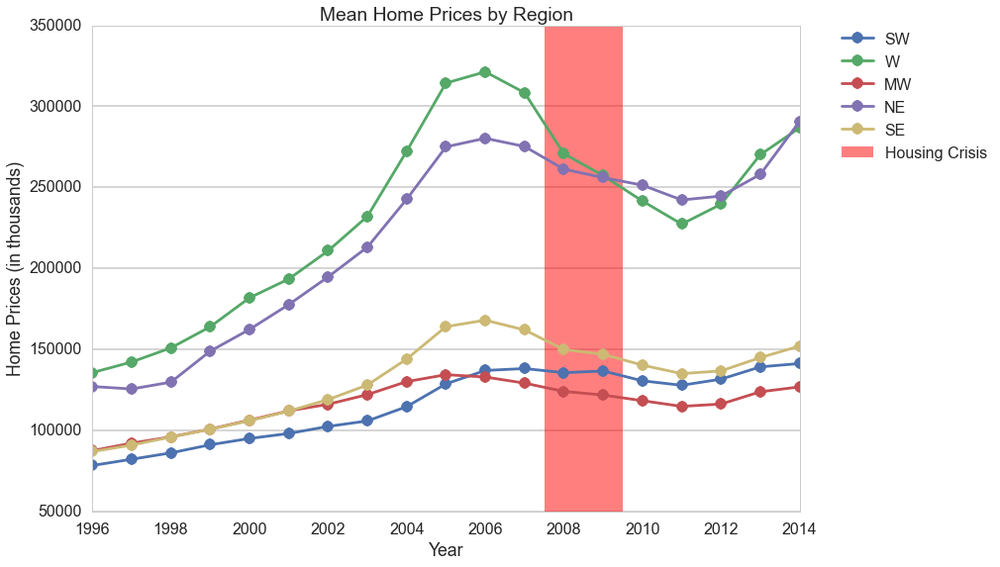

In [26]:
plt.plot(list(SWdf_time.mean().index),list(SWdf_time.mean().values),'-o',label = "SW")
plt.plot(list(Wdf_time.mean().index),list(Wdf_time.mean().values),'-o',label = "W")
plt.plot(list(MWdf_time.mean().index),list(MWdf_time.mean().values),'-o',label = "MW")
plt.plot(list(NEdf_time.mean().index),list(NEdf_time.mean().values),'-o',label = "NE")
plt.plot(list(SEdf_time.mean().index),list(SEdf_time.mean().values),'-o',label = "SE")
plt.axvspan(2007.5, 2009.5, color='r', alpha=0.5, lw=0,label = "Housing Crisis")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.grid(axis = "x")
plt.ylabel('Home Prices (in thousands)')
plt.xlabel('Year')
plt.title('Mean Home Prices by Region')
plt.show()

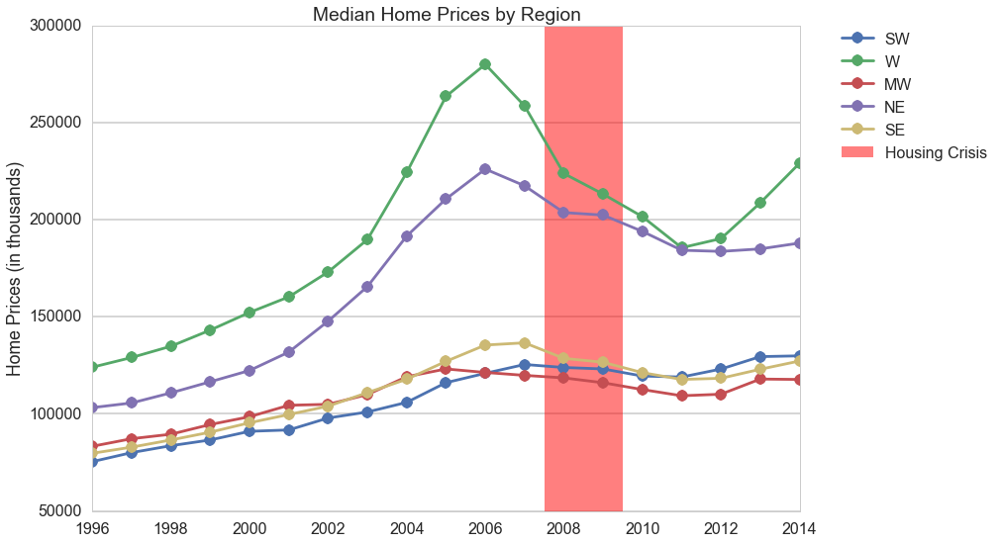

In [27]:
plt.plot(list(SWdf_time.median().index),list(SWdf_time.median().values),'-o',label = "SW")
plt.plot(list(Wdf_time.median().index),list(Wdf_time.median().values),'-o',label = "W")
plt.plot(list(MWdf_time.median().index),list(MWdf_time.median().values),'-o',label = "MW")
plt.plot(list(NEdf_time.median().index),list(NEdf_time.median().values),'-o',label = "NE")
plt.plot(list(SEdf_time.median().index),list(SEdf_time.median().values),'-o',label = "SE")
plt.axvspan(2007.5, 2009.5, color='r', alpha=0.5, lw=0,label = "Housing Crisis")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.grid(axis = "x")
plt.ylabel('Home Prices (in thousands)')
plt.title('Median Home Prices by Region')
plt.show()

Well this is interesting! In 1996, the housing prices were relatively close between all 5 regions, however over the course of the next 10 years, a large gap emerged as both the West and the Northeast home prices more than doubled, while the other three regions remained relatively constant over the entire time period. The West and NorthEast were also largely affected by the housing crisis while the other three regions were barely affected. This leads one to infer that the majority of the "bubble" that arose was from properties in the West and the Northeast. This concept is shown quite nicely by our maps we produce later on.

#### Since there are some obvious differences between these regions, lets do some seperate exploratory analysis for each region. Random Forest Regression was the best method used so far by a large margin, so we will run it on each individual region in 2010 as well.

# Northeast

In [237]:
from sklearn.cross_validation import train_test_split
# first create a copy of the entire dataframe
dftouse1 = NEdf.copy()
itrain1, itest1 = train_test_split(range(dftouse1.shape[0]), train_size=0.7)

mask1=np.ones(dftouse1.shape[0], dtype='int')
mask1[itrain1]=1
mask1[itest1]=0
mask1 = (mask1==1)
len(dftouse)

110

In [238]:
woprice1 = dftouse1.drop('Price',1)
woprice1 = woprice1.drop('Location',1)

X_train1 = woprice[mask1]
y_train1 = dftouse.Price[mask1]
X_test1 = woprice[~mask1]
y_test1 = dftouse.Price[~mask1]

Average error ($1000s): 5.072
Train Score: 0.95
Test Score: 0.65


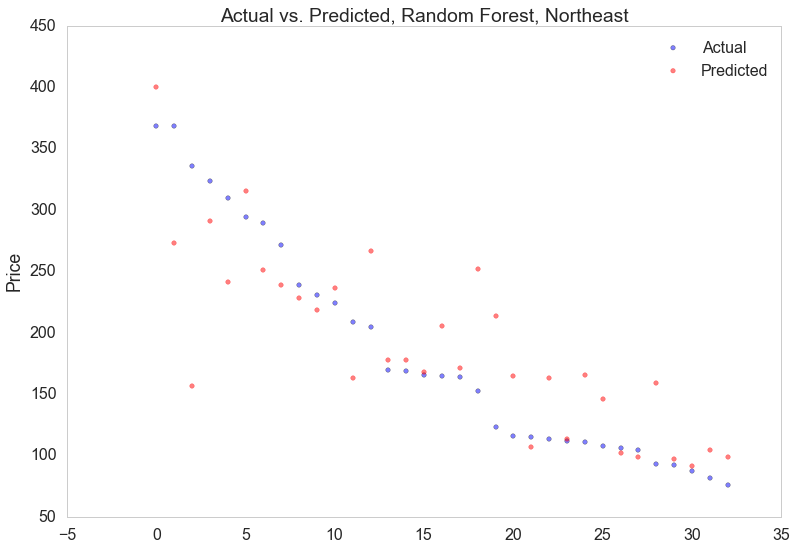

In [248]:
NEforest = ensemble.RandomForestRegressor(n_estimators=15)
NEforest.fit(X_train1,y_train1)
NEforestpreds = NEforest.predict(X_test1)
NEforesterrors = NEforestpreds - y_test1
print("Average error ($1000s): %.3f"% np.mean(NEforesterrors))
print('Train Score: %0.2f'%NEforest.score(X_train1,y_train1))
print('Test Score: %0.2f'%NEforest.score(X_test1,y_test1))

#Let's also plot the actual vs predicted values
count = [x for x in range(0,len(y_test1),1)]
plt.scatter(count,y_test1,alpha=0.5)
plt.scatter(count,NEforestpreds,color='r',alpha=0.5)
plt.title("Actual vs. Predicted, Random Forest, Northeast")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

Standard deviation of errors ($1000s): 52.634


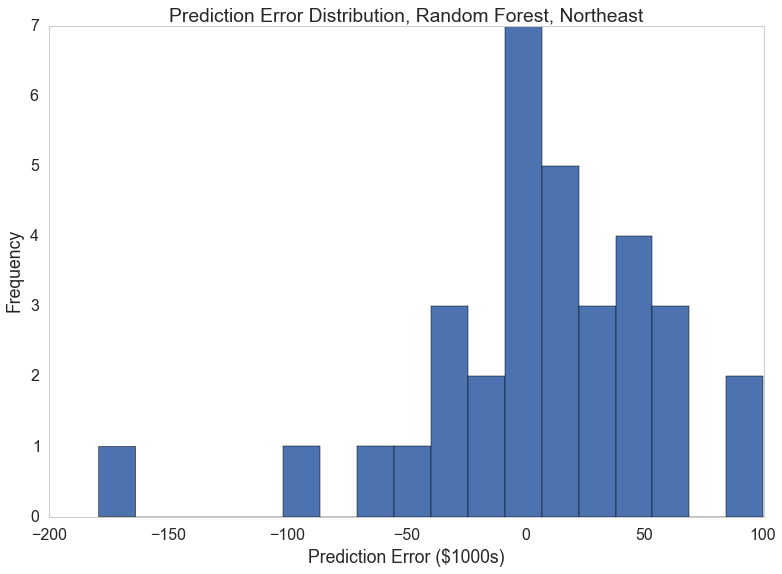

In [250]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(NEforesterrors))
plt.hist(NEforesterrors.values,bins=18)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Random Forest, Northeast')

# South-East

In [275]:
dftouse2 = SEdf.copy()
itrain2, itest2 = train_test_split(range(dftouse2.shape[0]), train_size=0.7)

mask2=np.ones(dftouse2.shape[0], dtype='int')
mask2[itrain2]=1
mask2[itest2]=0
mask2 = (mask2==1)
print(len(dftouse2))

276


In [276]:
woprice2 = dftouse2.drop('Price',1)
woprice2 = woprice2.drop('Location',1)

X_train2 = woprice2[mask2]
y_train2 = dftouse2.Price[mask2]
X_test2 = woprice2[~mask2]
y_test2 = dftouse2.Price[~mask2]

Average error ($1000s): 3.012
Train Score: 0.91
Test Score: 0.54


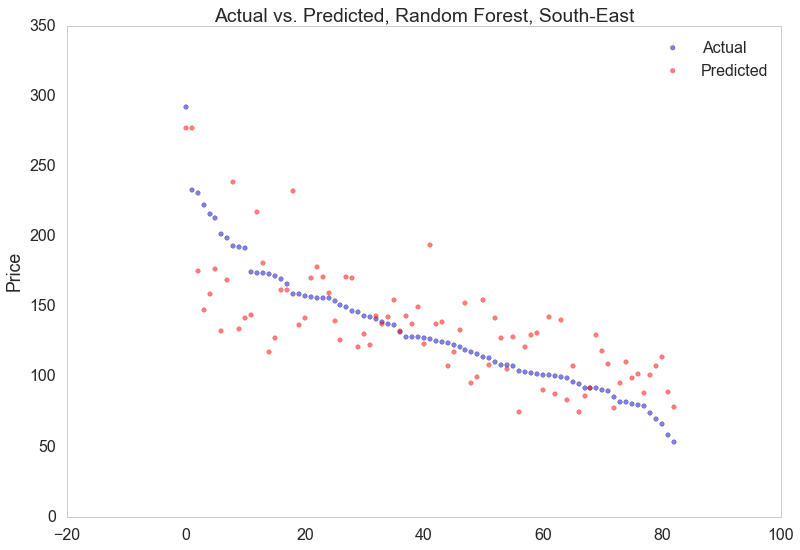

In [296]:
SEforest = ensemble.RandomForestRegressor(n_estimators=20)
SEforest.fit(X_train2,y_train2)
SEforestpreds = SEforest.predict(X_test2)
SEforesterrors = SEforestpreds - y_test2
print("Average error ($1000s): %.3f"% np.mean(SEforesterrors))
print('Train Score: %0.2f'%SEforest.score(X_train2,y_train2))
print('Test Score: %0.2f'%SEforest.score(X_test2,y_test2))

#Let's also plot the actual vs predicted values
count = [x for x in range(0,len(y_test2),1)]
plt.scatter(count,y_test2,alpha=0.5)
plt.scatter(count,SEforestpreds,color='r',alpha=0.5)
plt.title("Actual vs. Predicted, Random Forest, South-East")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

Standard deviation of errors ($1000s): 30.277


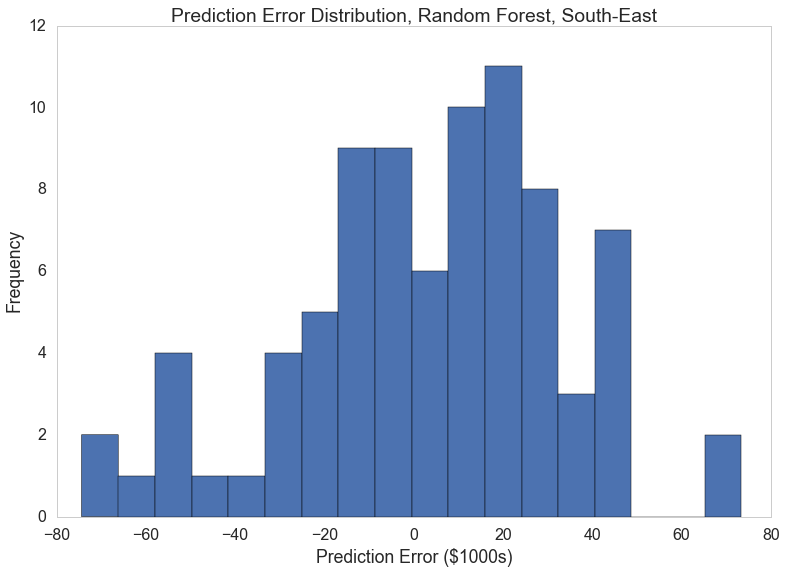

In [298]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(SEforesterrors))
plt.hist(SEforesterrors.values,bins=18)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Random Forest, South-East')

# West

In [315]:
dftouse3 = Wdf.copy()
itrain3, itest3 = train_test_split(range(dftouse3.shape[0]), train_size=0.7)

mask3=np.ones(dftouse3.shape[0], dtype='int')
mask3[itrain3]=1
mask3[itest3]=0
mask3 = (mask3==1)
print(len(dftouse3))

woprice3 = dftouse3.drop('Price',1)
woprice3 = woprice3.drop('Location',1)

X_train3 = woprice3[mask3]
y_train3 = dftouse3.Price[mask3]
X_test3 = woprice3[~mask3]
y_test3 = dftouse3.Price[~mask3]

127


Average error ($1000s): 26.632
Train Score: 0.77
Test Score: 0.57


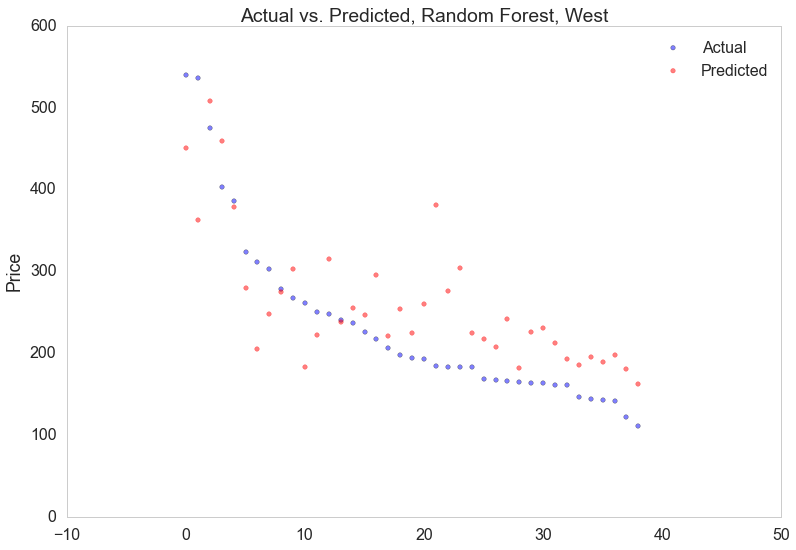

In [316]:
Wforest = ensemble.RandomForestRegressor(n_estimators=15)
Wforest.fit(X_train3,y_train3)
Wforestpreds = Wforest.predict(X_test3)
Wforesterrors = Wforestpreds - y_test3
print("Average error ($1000s): %.3f"% np.mean(Wforesterrors))
print('Train Score: %0.2f'%Wforest.score(X_train3,y_train3))
print('Test Score: %0.2f'%Wforest.score(X_test3,y_test3))

#Let's also plot the actual vs predicted values
count = [x for x in range(0,len(y_test3),1)]
plt.scatter(count,y_test3,alpha=0.5)
plt.scatter(count,Wforestpreds,color='r',alpha=0.5)
plt.title("Actual vs. Predicted, Random Forest, West")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

If you get Pitkin, CO in the test set, the score will be horrible, otherwise we still do quite well. 

Standard deviation of errors ($1000s): 64.060


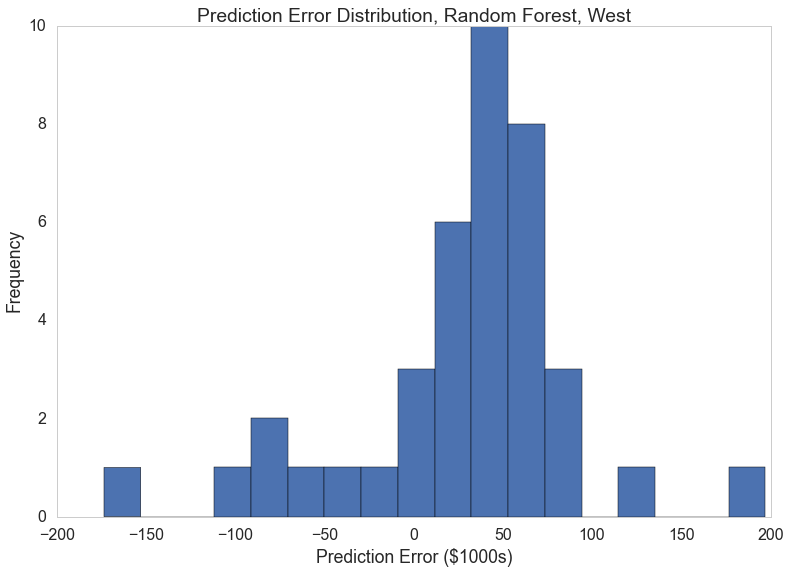

In [317]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(Wforesterrors))
plt.hist(Wforesterrors.values,bins=18)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Random Forest, West')

# Mid-West

In [331]:
dftouse4 = MWdf.copy()
itrain4, itest4 = train_test_split(range(dftouse4.shape[0]), train_size=0.7)

mask4=np.ones(dftouse4.shape[0], dtype='int')
mask4[itrain4]=1
mask4[itest4]=0
mask4 = (mask4==1)
print(len(dftouse4))

woprice4 = dftouse4.drop('Price',1)
woprice4 = woprice4.drop('Location',1)

X_train4 = woprice4[mask4]
y_train4 = dftouse4.Price[mask4]
X_test4 = woprice4[~mask4]
y_test4 = dftouse4.Price[~mask4]

167


Average error ($1000s): 1.112
Train Score: 0.93
Test Score: 0.67


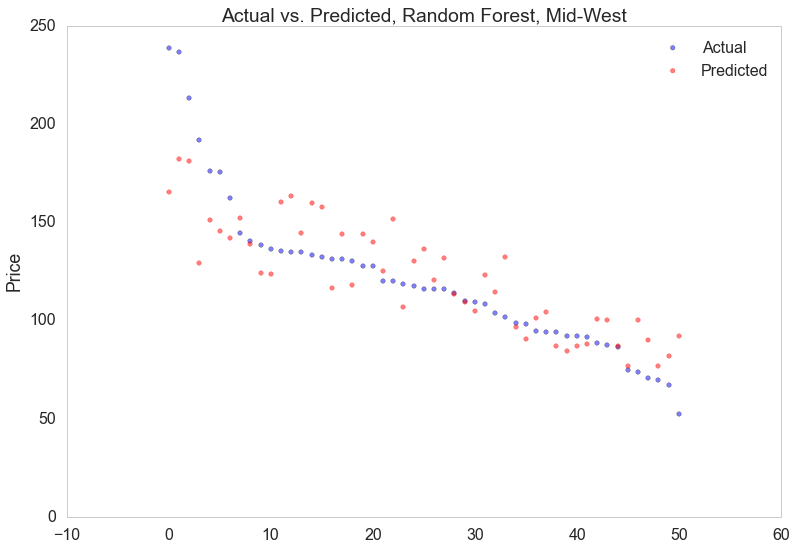

In [335]:
MWforest = ensemble.RandomForestRegressor(n_estimators=15)
MWforest.fit(X_train4,y_train4)
MWforestpreds = MWforest.predict(X_test4)
MWforesterrors = MWforestpreds - y_test4
print("Average error ($1000s): %.3f"% np.mean(MWforesterrors))
print('Train Score: %0.2f'%MWforest.score(X_train4,y_train4))
print('Test Score: %0.2f'%MWforest.score(X_test4,y_test4))

#Let's also plot the actual vs predicted values
count = [x for x in range(0,len(y_test4),1)]
plt.scatter(count,y_test4,alpha=0.5)
plt.scatter(count,MWforestpreds,color='r',alpha=0.5)
plt.title("Actual vs. Predicted, Random Forest, Mid-West")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

Standard deviation of errors ($1000s): 22.689


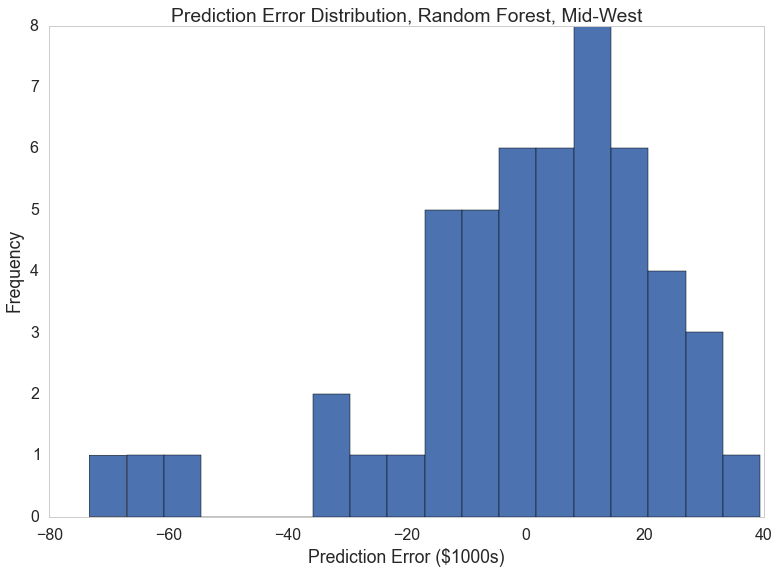

In [336]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(MWforesterrors))
plt.hist(MWforesterrors.values,bins=18)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Random Forest, Mid-West')

# South-West

In [362]:
dftouse5 = SWdf.copy()
itrain5, itest5 = train_test_split(range(dftouse5.shape[0]), train_size=0.7)

mask5=np.ones(dftouse5.shape[0], dtype='int')
mask5[itrain5]=1
mask5[itest5]=0
mask5 = (mask5==1)
print(len(dftouse5))

woprice5 = dftouse5.drop('Price',1)
woprice5 = woprice5.drop('Location',1)

X_train5 = woprice5[mask5]
y_train5 = dftouse5.Price[mask5]
X_test5 = woprice5[~mask5]
y_test5 = dftouse5.Price[~mask5]

78


Average error ($1000s): 4.527
Train Score: 0.90
Test Score: 0.38


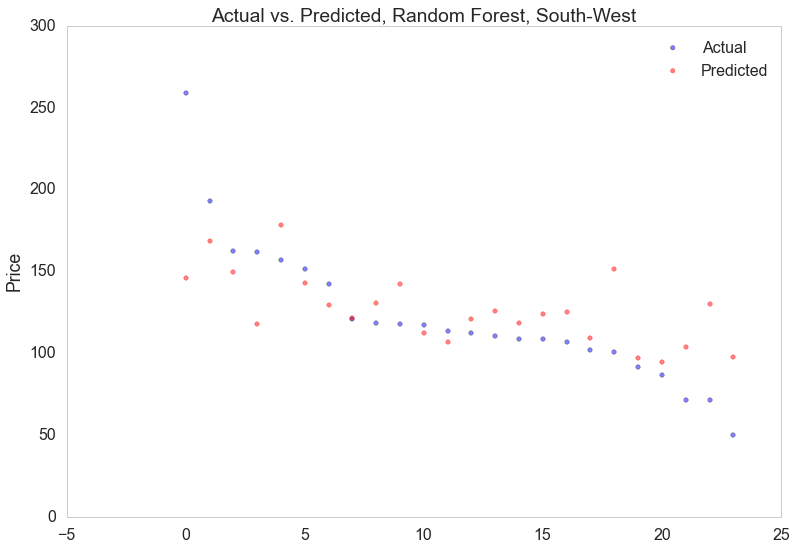

In [363]:
SWforest = ensemble.RandomForestRegressor(n_estimators=20)
SWforest.fit(X_train5,y_train5)
SWforestpreds = SWforest.predict(X_test5)
SWforesterrors = SWforestpreds - y_test5
print("Average error ($1000s): %.3f"% np.mean(SWforesterrors))
print('Train Score: %0.2f'%SWforest.score(X_train5,y_train5))
print('Test Score: %0.2f'%SWforest.score(X_test5,y_test5))

#Let's also plot the actual vs predicted values
count = [x for x in range(0,len(y_test5),1)]
plt.scatter(count,y_test5,alpha=0.5)
plt.scatter(count,SWforestpreds,color='r',alpha=0.5)
plt.title("Actual vs. Predicted, Random Forest, South-West")
plt.ylabel('Price')
plt.legend(['Actual','Predicted'])
plt.grid(False)

The Random Forest for the South-West doesn't work super well, most likely because it has the smallest sample of counties that contained all of our data.

Standard deviation of errors ($1000s): 33.424


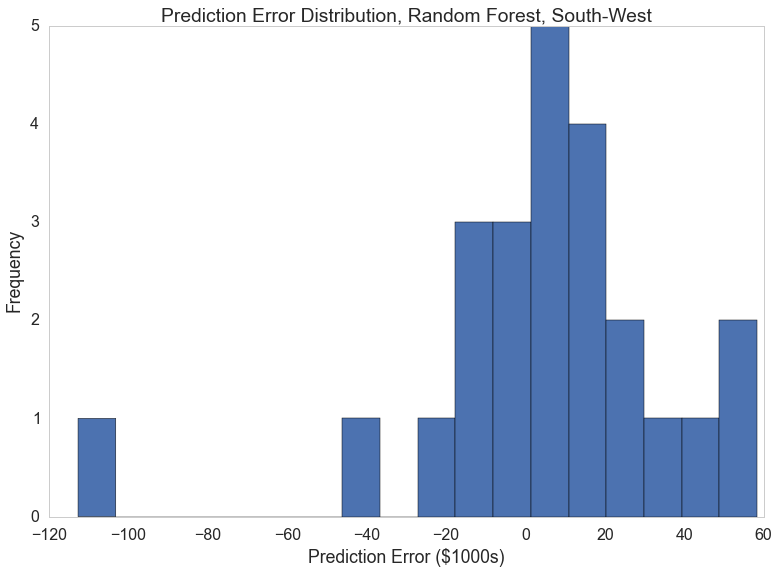

In [364]:
print("Standard deviation of errors ($1000s): %.3f"% np.std(SWforesterrors))
plt.hist(SWforesterrors.values,bins=18)
plt.grid(False)
plt.ylabel('Frequency')
plt.xlabel('Prediction Error ($1000s)')
plt.title('Prediction Error Distribution, Random Forest, South-West')

With the exception of the South-West, we matched or improved upon the accuracy results from the full US regression and substantially lowered the standard deviation in all cases (again, depending on the initial mask from the full dataframe and the individual masks for the by-region data frames, this could be off). We'd call this a success! 

# Visualizations
### Let's create a map to see which counties we're considering across the US in our 2010 analysis:
To do this, we need to read in the FIPS codes corresponding to each county we are considering. The csv we're reading in is adapted and cleaned up from http://www.census.gov/geo/reference/codes/cou.html to make things easier. 

In [28]:
fips_codes = pd.read_csv('US_FIPS_Codes.csv')

# map each written state name to its abbreviation with a dictionary we create
fips_codes['State'] = fips_codes.apply(lambda x: state_abbr.get(x['State']), axis=1)

# make new column with county and state name because some county names are repeated across states
for index,row in fips_codes.iterrows():
    # make sure there are no spaces in the location so it's all standardized (fixes inconsistency issues in naming) 
    location = (row['County']+','+row['State']) 
    location = location.replace(" ", "")
    # also make the whole location lowercase so everything is consistent 
    fips_codes.loc[index,'Location'] = location.lower()
# remove the state and county columns now that we've created one for the unique location
fips_codes = fips_codes.drop(fips_codes.columns[[0,1]],axis=1)
fips_codes = fips_codes[['Location','Code']]
# now let's make a dictionary so we can map each county in the larger dataframe to a FIPS code
fips_dict = fips_codes.set_index('Location')['Code'].to_dict()

Now that we have the fips codes, we can create a smaller dataframe with only the prices in each county and the corresponding FIPS code. This will allow us to make the US plots with each county colored according to it's average housing cost.

In [29]:
fips_df_copy = full_2010df[['Location','Price']]

# remove Pitkin, CO from the dataframe (reasoning discussed in the next paragraph of text)
# got this code idea from http://chrisalbon.com/python/pandas_dropping_column_and_rows.html
fips_df_copy = fips_df_copy[fips_df_copy['Location'] != 'pitkin,co']

fips_df_copy['FIPS'] = fips_df_copy.apply(lambda x: fips_dict.get(x['Location']), axis=1)
fips_price_df = fips_df_copy[['FIPS','Price']]
price_array = fips_price_df['Price'].values
min_price = min(price_array)
max_price = max(price_array)

# we might consider manually setting the price for Pitkin, CO because you lose some ability to differentiate 
# among the other counties' prices because the high price dominates the scaling

# shift and scale the pricing data so it's between 0-1 (for the purposes of plotting)
scaled_pricing = (price_array - min_price)/(max_price)
fips_price_df['Price'] = scaled_pricing

# finally, let's make this a dictionary so it's easier to use with the plotting function we'll use next
fips_price_dict = fips_price_df.set_index('FIPS')['Price'].to_dict()

/Users/ericrodrigo/anaconda/lib/python2.7/site-packages/IPython/kernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


Let's start writing the code to create the US county figures. The majority of the code here is adapted from an article by Nathan Yau found here: http://flowingdata.com/2009/11/12/how-to-make-a-us-county-thematic-map-using-free-tools/.

#### A note about the plots below: 
We made the aesthetic choice to remove Pitkin, CO from the map visualizations because the distribution of colors was skewed so heavily by the outlier. With Pitkin included, most of the other counties were a very similar, dark shade of red while Pitkin was entirely white, which is in line with our color map. The distribution of colors that we get by omitting Pitkin from the maps gives you a much better idea of the pricing distribution across the other counties in the US that we are considering in our 2010 analysis. We hope this is an acceptable omission. 

In [30]:
import csv
from matplotlib.colors import rgb2hex
from bs4 import BeautifulSoup
 
# set the colormap we'll be using for the plot
cmap=plt.get_cmap('afmhot')    

# Load the SVG map
svg = open('USA_Counties_with_FIPS_and_names.svg', 'r').read()
soup = BeautifulSoup(svg)
paths = soup.findAll('path')

# Change colors accordingly
path_style = 'font-size:12px;fill-rule:nonzero;stroke:#000000;stroke-opacity:1;stroke-width:0.1;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel;fill:'

# iterate through all county boundaries
for p in paths:
    if p['id'] not in ["State_Lines", "separator"]:
        try:
            # see if the path id (county FIPS id) is in the fips_price_dict, converting it to an int
            # if it is, get the color from there representing its relative price
            color = rgb2hex(cmap(fips_price_dict.get(int(p['id']))))
        except:
            continue
        # append the price-relative color to each county that was contained in the dataframe
        p['style'] = path_style + color

# output a unicode text object that's an svg text file of the US map
svg_text = soup.prettify()

# we need to replace the state and county border colors that are black or grey with white
# got help from http://stackoverflow.com/questions/13093727/how-to-replace-unicode-characters-in-string-with-something-else-python

# replace the county borders with white and increase stroke width (made text to match long to ensure accuracy)
svg_text = svg_text.replace(u'stroke:#000000;stroke-opacity:1;stroke-width:0.1;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel',u'stroke:#ffffff;stroke-opacity:1;stroke-width:0.25;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel')

# now change the state borders so they're white too and increase linewidth
svg_text = svg_text.replace(u'fill:none;stroke:#221e1f;stroke-width:0.5;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4',u'fill:none;stroke:#ffffff;stroke-width:0.9;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4')

# make the separator between hawaii/alaska and the rest of the US white so we don't see it
svg_text = svg_text.replace(u'stroke:#a9a9a9',u'stroke:#ffffff')

f = open('first_price_map_2010.svg', 'wb')
f.write(svg_text.encode('utf8'))
f.close()

/Users/ericrodrigo/anaconda/lib/python2.7/site-packages/bs4/__init__.py:166: UserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("lxml"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

To get rid of this warning, change this:

 BeautifulSoup([your markup])

to this:

 BeautifulSoup([your markup], "lxml")

  markup_type=markup_type))


Let's create a color gradient image with the color pallette we're using so we can add it as a legend to the map images we make. From http://matplotlib.org/xkcd/examples/color/colormaps_reference.html.

In [53]:
# function to plot the gradient (adapted from http://matplotlib.org/xkcd/examples/color/colormaps_reference.html)
def plot_color_gradient(cmap_name):
    plt.imshow(gradient,aspect='auto',cmap=plt.get_cmap(cmap_name))
    #ax.set_axis_off()
    plt.grid(False)

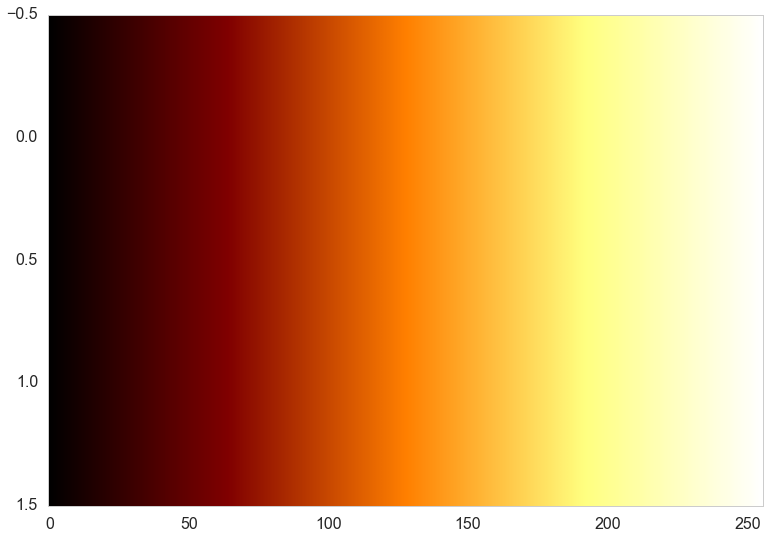

In [54]:
gradient = np.linspace(0, 1, 256)
gradient = np.vstack((gradient, gradient))
plot_color_gradient('afmhot')

### Create high-quality jpeg image from output text file:
The process of taking the text file that is output and saved at the end of the function above and making it into a jpeg image is one that required a lot of trial and error. We can save the text file (output as a beautifulSoup object) as a .svg file in the local directory. There is some unknown issue with the SVG file that the online platform creates, so we can't open it in Adobe Illustrator to perform further image editing. Instead, we have to open it in Google Chrome and print the SVG map image as a pdf document. From there we can use an online pdf cropping tool (https://www.cutepdf-editor.com/edit.asp) to uniformly crop all of our pdfs so that when we overlay them they line up perfectly. It is then simply a matter of exporting each pdf as a jpeg with the highest quality settings and 600 pixels/inch to retain good image quality. 

I played around with many other methods of exporting the text file, such as with the "svgwrite" toolkit, but these proved to behave in unexpected ways and were more trouble than they were worth (even moreso than this convoluted method I came up with). 

### Here's the final map after some formatting in Adobe Illustrator

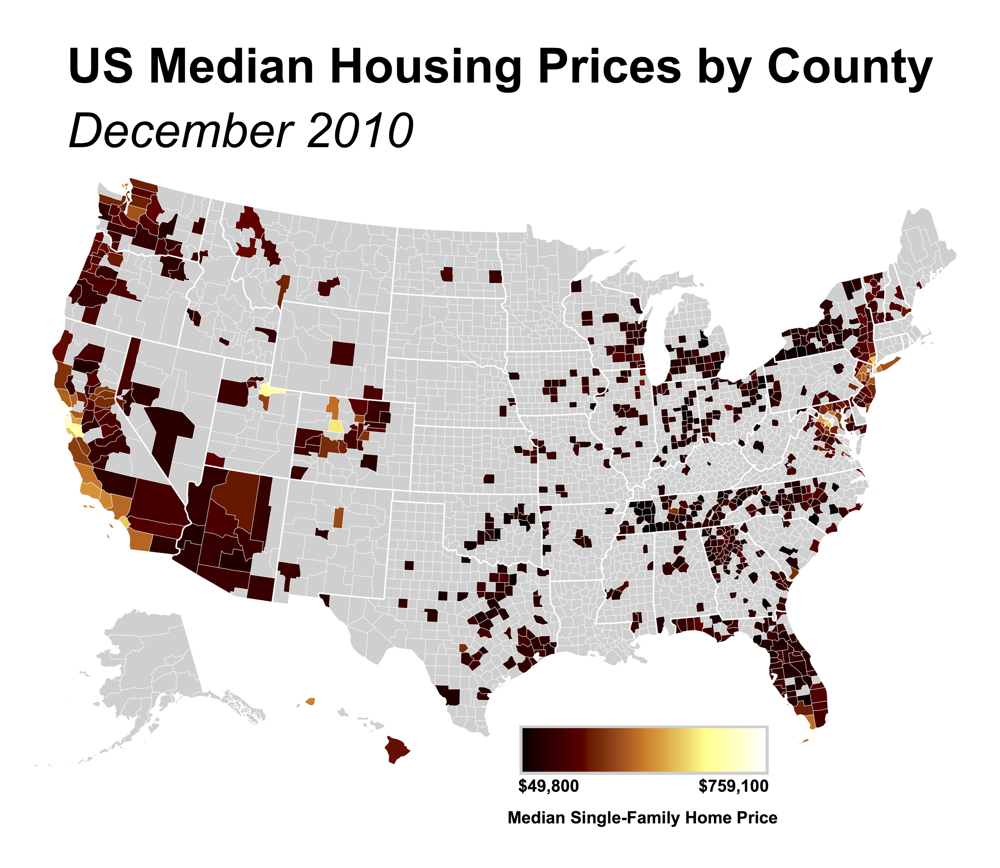

In [26]:
Image(filename='first_map_final.jpg') 

This graph gives us an interesting visualization of the US housing market. Most of the counties with expensive homes are on the coasts. For example, almost every county on the western border of California is bright, representing a higher than average median Home Price. 

Similarly, the Northeast is characterized by higher median home prices. 

Despite a few scattered counties across the US which have high median family home prices, most land-locked counties have lower home prices. 

In California, many of the counties with expensive home prices, such as Marin, were huge hubs for Gold Mining during the Gold Rush of the 1850s. However, the large gap today is predominatly due to the Silicon Valley boom in the past decade. 

## Let's create some images that show how housing prices changed across the US from Dec. 1996 - Dec. 2014:

#### Maximum and Minimum Price Normalization

The first set of textfiles that we output will be normalized to the highest and lowest housing prices that occur in any of the counties over the 19 year span. That is, the coloring on the maps that we eventually make will be scaled based on the max and min median prices in each county that has data for all of the years. Note that there will be more counties that we are considering in these map images because the only condition for a county to remain in the dataframe was that it had Zillow.com pricing data for December 1996-2014. This is compared to the 2010-12 dataframe that we created earlier, where we included other housing and demographics data for each county, limiting the number of counties that had complete data.

In [31]:
# get the overall maximum of the entire dataframe, ignoring the last row which has the location name as a string
max_price1 = max(county_prices.max().values[:(len(county_prices.max().values)-1)])

# get the min price
min_price1 = min(county_prices.min().values[:(len(county_prices.min().values)-1)])

# make list of the years we are considering 
years = ['1996-12','1997-12','1998-12','1999-12','2000-12','2001-12','2002-12','2003-12','2004-12','2005-12','2006-12','2007-12','2008-12','2009-12','2010-12','2011-12','2012-12','2013-12','2014-12']
# [1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014]
#years = range(1996,2015)
# let's also make a copy of the dataframe because now we're going to start shifting and shrinking the prices from 0-1
norm1 = county_prices.copy()

# key each location with the FIPS code rather than the county, state name
norm1['FIPS'] = norm1.apply(lambda x: fips_dict.get(x['Location']), axis=1)

# drop any columns that don't have a corresponding FIPS code
norm1 = norm1.dropna(axis=0,how='any')

# drop the Location column now
norm1 = norm1.drop('Location',1)

for year in years:
    # scale the home prices in each column according to this max and min
    price_array = norm1[year].values
    scaled_pricing = (price_array - min_price1)/(max_price1)
    norm1[year] = scaled_pricing
    
# now let's make a dictionary with all of these normalized values 
norm1_dict = norm1.set_index('FIPS').to_dict()

Let's make some maps, one for each year 1996-2014:

In [32]:
# iterate through all the years
for year in years:
    # iterate through all county boundaries
    for p in paths:
        if p['id'] not in ["State_Lines", "separator"]: 
            try:
                # see if the path id (county FIPS id) is in the fips_price_dict for the given year
                # if it is, get the color from there representing its relative price
                color = rgb2hex(cmap(norm1_dict.get(year).get(int(p['id']))))
            except:
                continue
            # append the price-relative color to each county that was contained in the dataframe
            p['style'] = path_style + color

    # make the same changes as before (uncommented this code because it's the same operations as above)
    # sorry I didn't make this into a nice function, things got complicated pretty fast once I started trying to do that
    svg_text = soup.prettify()
    svg_text = svg_text.replace(u'stroke:#000000;stroke-opacity:1;stroke-width:0.1;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel',u'stroke:#ffffff;stroke-opacity:1;stroke-width:0.25;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel')
    svg_text = svg_text.replace(u'fill:none;stroke:#221e1f;stroke-width:0.5;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4',u'fill:none;stroke:#ffffff;stroke-width:0.9;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4')
    svg_text = svg_text.replace(u'stroke:#a9a9a9',u'stroke:#ffffff')
    f = open('norm1_text_'+str(year)+'.svg', 'wb')
    f.write(svg_text.encode('utf8'))
    f.close()

The map for 2014 is below (other years' plots look similar).

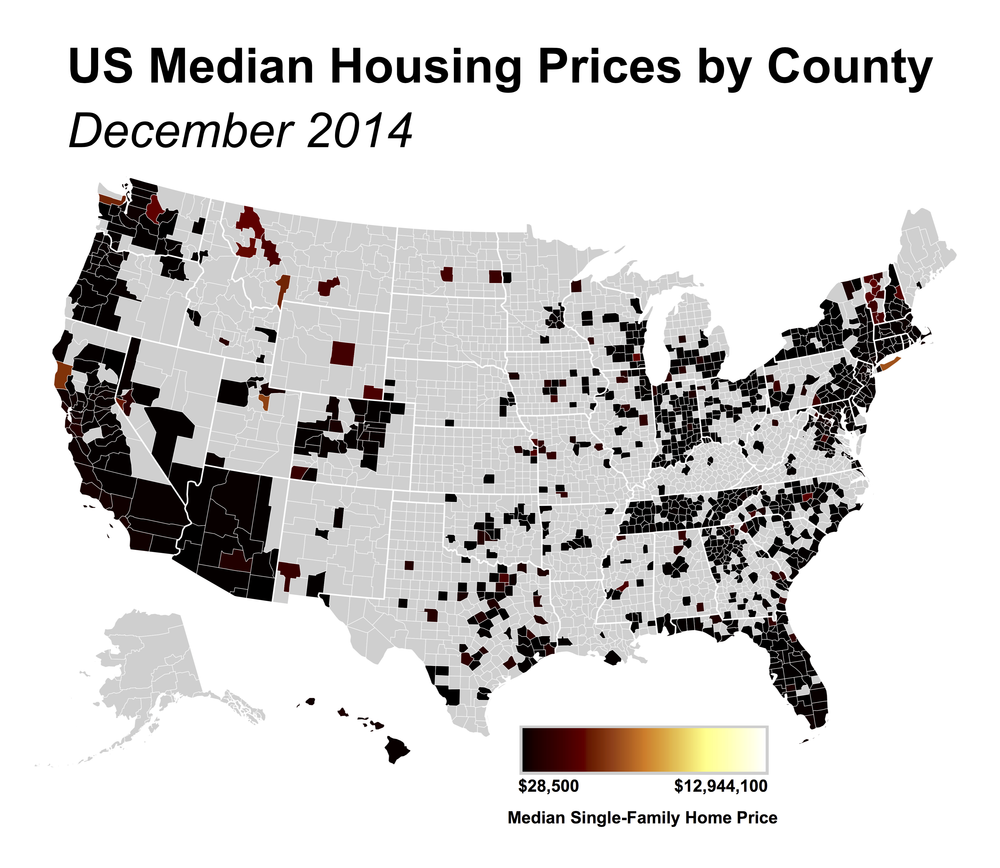

In [172]:
Image(filename='w_ny_2014_final.jpg') 

Hmmm...something seems off here, every county seems to be very dark, indicating a low relative price.

We can make a histogram of the standardized prices for a certain year to examine their distribution: 

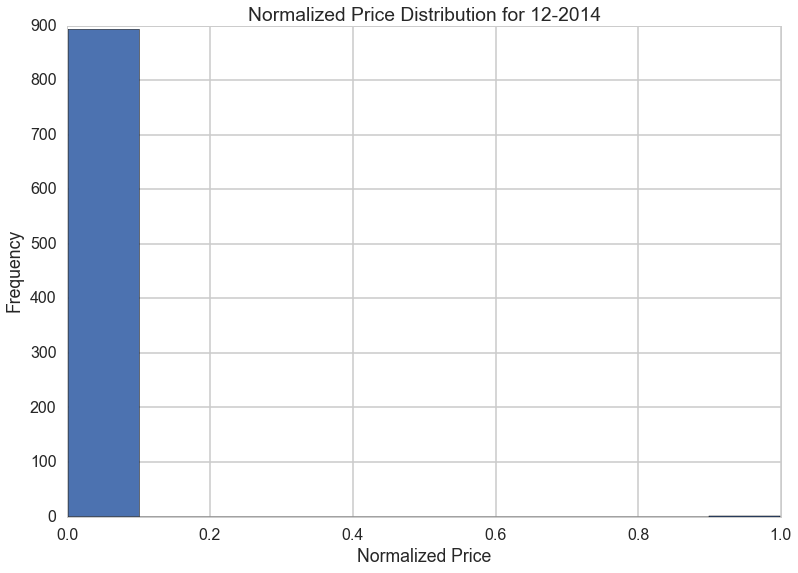

In [33]:
samp_norm_lst = norm1_dict.get("2014-12").values()
plt.hist(samp_norm_lst,bins=10)
plt.ylabel('Frequency')
plt.xlabel('Normalized Price')
plt.title('Normalized Price Distribution for 12-2014')

Clearly, there is some outlier that's causing our normalized pricing data to be concentrated around zero. Let's investigate further...

In [34]:
max_norm = max(samp_norm_lst)
print('The maximum normalized median home price in December 2014 is:', max_norm)

('The maximum normalized median home price in December 2014 is:', 0.99779822467378965)


In [1]:
# norm1_dict.get("2014-12")

From the dictionary above, we can see that the outlier price comes from FIPS code 36061, New York County (Manhattan), NY. Let's see how the distribution of prices looks if we remove this county from the set (just as a trial). We can first convert the normalized price back to the actual median price in 2014-12 and compare to the dataframe to check that we didn't make any mistakes in normalizing.

In [36]:
# convert to actual price in 2014-12
act_ny_price = (max_norm*max_price1)+min_price1
print'The actual NYC median housing price in December 2014 is: $',act_ny_price

The actual NYC median housing price in December 2014 is: $ 12944100.0


Now let's sort the dataframe from before to see which counties are the most expensive. Let's also move Location to the front of the dataframe so you don't have to scroll.

In [38]:
county_sorted = county_prices.sort('2014-12',ascending=False)
cols = list(county_sorted)
# move the column to head of list using index, pop and insert
cols.insert(0, cols.pop(cols.index('Location')))
county_sorted = county_sorted.ix[:, cols]
county_sorted.head()

,Location,1996-12,1997-12,1998-12,1999-12,2000-12,2001-12,2002-12,2003-12,2004-12,2005-12,2006-12,2007-12,2008-12,2009-12,2010-12,2011-12,2012-12,2013-12,2014-12
18,"newyork,ny",2837200,2224900,2074400,3847400,4249200,4571500,4285000,3909200,4484000,5822400,6161800,6404900,6582800,6650100,6890300,6794200,7252200,8259900,12944100
237,"marin,ca",357400,390900,440300,525700,623600,656700,697400,738200,870800,948500,934200,916400,825300,796600,759100,743900,797800,929500,981600
61,"sanfrancisco,ca",267600,299900,336700,400500,482400,497100,564700,615800,722100,796600,779100,828700,740600,710200,704000,677000,763300,903200,979900
75,"sanmateo,ca",306300,343600,385000,457200,558700,543500,593000,641200,761600,840600,843000,833900,738700,729800,695800,675900,759400,899100,978300
15,"santaclara,ca",284700,334100,372000,440200,568300,520600,569300,579400,691800,785500,791000,785700,684300,651600,652600,632600,722800,834700,912600


Woah, it's no wonder the maps I made turned out so poorly when we keep New York County in the dataframe, it's median single-family home price is over ten times the next closest (Marin County, CA). This isn't all that surprsing, though, considering that we are only considering single family home prices in the relatively small, urban county that is Manhattan. The only single family homes within the county lines are understandably expensive relative to the rest of the US. Everything else is black or very dark red on the maps I made, while New York County is bright white because all of the other counties' prices were normalized to it. Even if it isn't the most accurate representation of the data, let's try redrawing the maps without New York County to see how they look. 

In [39]:
no_nyc = county_sorted[county_sorted['Location'] != 'newyork,ny']

# key each location with the FIPS code rather than the county, state name
no_nyc['FIPS'] = no_nyc.apply(lambda x: fips_dict.get(x['Location']), axis=1)

# drop any columns that don't have a corresponding FIPS code
no_nyc = no_nyc.dropna(axis=0,how='any')

# drop the Location column now
no_nyc = no_nyc.drop('Location',1)

# make a copy of this for a later block of code
no_nyc_for_later = no_nyc.copy()

# let's get the new max
no_nyc_max = max(no_nyc.max().values[:(len(no_nyc.max().values)-1)])

# let's renormalize the data
for year in years:
    # scale the home prices in each column according to this max and min
    price_array = no_nyc[year].values
    scaled_pricing = (price_array - min_price1)/(no_nyc_max)
    no_nyc[year] = scaled_pricing
    
# now let's make a dictionary with all of these normalized values 
no_nyc_dict = no_nyc.set_index('FIPS').to_dict()

/Users/ericrodrigo/anaconda/lib/python2.7/site-packages/IPython/kernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


Now that we have a dictionary keyed with each year and FIPS code, we can create all of the different maps.

In [40]:
# iterate through all the years
for year in years:
    # iterate through all county boundaries
    for p in paths:
        if p['id'] not in ["State_Lines", "separator"]: 
            try:
                # see if the path id (county FIPS id) is in the fips_price_dict for the given year
                # if it is, get the color from there representing its relative price
                color = rgb2hex(cmap(no_nyc_dict.get(year).get(int(p['id']))))
            except:
                continue
            # append the price-relative color to each county that was contained in the dataframe
            p['style'] = path_style + color

    # make the same changes as before (uncommented this code because it's the same operations as above)
    # sorry I didn't make this into a nice function, things got complicated pretty fast once I started trying to do that
    svg_text = soup.prettify()
    svg_text = svg_text.replace(u'stroke:#000000;stroke-opacity:1;stroke-width:0.1;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel',u'stroke:#ffffff;stroke-opacity:1;stroke-width:0.25;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel')
    svg_text = svg_text.replace(u'fill:none;stroke:#221e1f;stroke-width:0.5;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4',u'fill:none;stroke:#ffffff;stroke-width:0.9;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4')
    svg_text = svg_text.replace(u'stroke:#a9a9a9',u'stroke:#ffffff')
    f = open('norm1_text_'+str(year)+'.svg', 'w')
    f.write(svg_text.encode('utf8'))
    f.close()

Now that we're starting to work with much larger sets of images, I used the Automator app for Mac to automate the process of rendering the pdf files (that I created from the svg images) as high-quality jpeg images. I got the idea from here: http://www.mactricksandtips.com/2013/03/how-to-save-pdfs-as-jpegs-including-multi-page-pdfs.html.

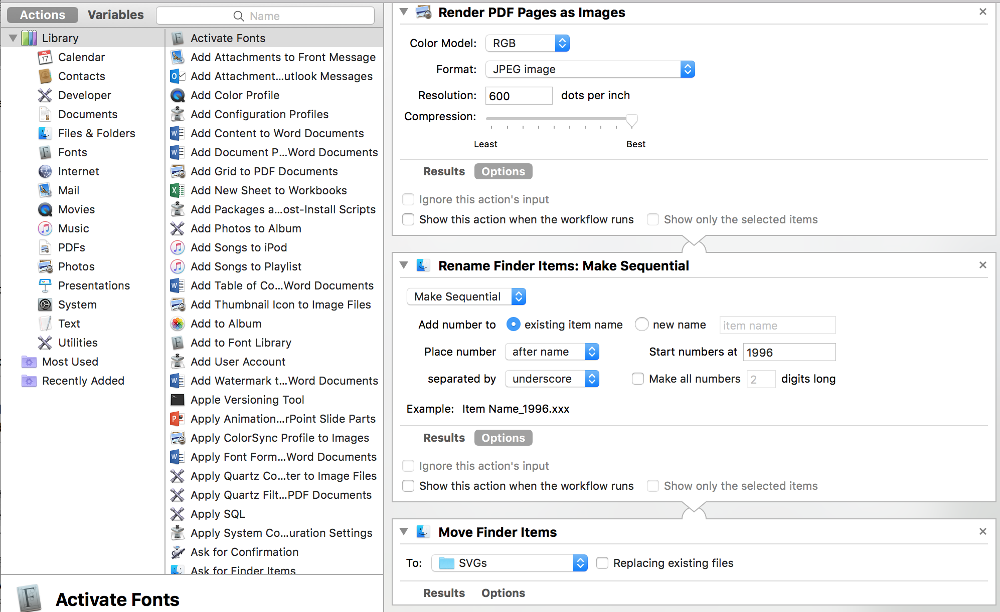

In [134]:
Image(filename='automator_screenshot.png', height = 300, width = 600) 

After fixing all of the labels in Illustrator (which took a significant amount of time), I created a looping slideshow of the changing housing prices that you can see here: 
###*Make sure to actually run this box, pre-executed notebooks will not display the image. You do not need to run anything else in the notebook to be able to run this block. Alternatively just copy the link into a browser.*

In [11]:
from IPython.display import IFrame
from IPython.display import display

IFrame(src="https://docs.google.com/a/college.harvard.edu/presentation/d/1i_7NzNgHgebzK0mPHbff47cP_dlW81XkK4gzB1OeTYA/embed?start=true&loop=true&delayms=1200",width = 750, height = 400)

Notice how the coastal counties experience much more variation in price than the landlocked cities. You can see that they were hit hard by the 2008 recession

It seems like some counties had a greater change in price than others, let's see if we can explore this phenomenon further. We can rank the counties based on their price volatility (the minimum price in the 19 year period subtracted from the maximum price) controlled for inflation. I start by reading in a csv file containing the consumer price indices for the timespan under consideration. I preprocessed a much larger dataset in excel so this one would be easier to work with. The CPI dataset is from https://www.quandl.com/collections/usa/usa-inflation-prices.

We can think of the relative values of the consumer price indices over the years as a way to control for inflation, based on the percent change in CPI. 

*NOTE:* Pitkin, CO was removed from the frame for creating this heatmap because it is so much more expensive that it throws off the color gradient (all others are very dark)

In [46]:
# Let's read in the consumer price index datafile
CPIs = pd.read_csv('CPI_small_dataset.csv')

CPIs_array = CPIs['Value'].values

# our starting point is the CPI in December of 1996
cpi_96 = list(CPIs_array)[-1]

# let's find the percent change in CPI for December of each of the subsequent years (in the form of a multiplier)
multipliers = 1/(((CPIs_array - cpi_96)/cpi_96)+1)

# add these to a dictionary with the dates
inflat_dict = dict(zip(list(CPIs['Date'].values),multipliers))
inflat_dict

{'1996-12': 1.0,
 '1997-12': 0.98326100433973951,
 '1998-12': 0.96766320927394733,
 '1999-12': 0.94236482471776584,
 '2000-12': 0.91149425287356312,
 '2001-12': 0.89756649688737977,
 '2002-12': 0.87672747374239901,
 '2003-12': 0.86055344546934343,
 '2004-12': 0.8334209143457697,
 '2005-12': 0.80589430894308933,
 '2006-12': 0.78592666005946477,
 '2007-12': 0.7551086480412883,
 '2008-12': 0.7544190117396351,
 '2009-12': 0.73443266697229437,
 '2010-12': 0.7236094698853448,
 '2011-12': 0.7027898897514977,
 '2012-12': 0.69076354197063594,
 '2013-12': 0.68054357667271681,
 '2014-12': 0.67543396419263069}

This seems to look good, let's start correcting the median house prices in each year to account for inflation.

In [48]:
# start by making a copy of the dataframe
inflat_df = no_nyc_for_later

# get all the year column names
years_lst = list(inflat_df.columns.values)[:-1]

# iterate through all the year columns and correct them for inflation
for year in years_lst:
    inflat_dict.get(years_lst[12])
    inflat_df[year] = list((inflat_df[year].values)*inflat_dict.get(year))

# get the max and min of the dataframe
no_infl_max = max(inflat_df.max().values[:(len(inflat_df.max().values)-1)])
no_infl_min = min(inflat_df.min().values[:(len(inflat_df.min().values)-1)])

# let's renormalize the data
for year in years_lst:
    # scale the home prices in each column according to this max and min to get the colors correct on the map
    price_array = inflat_df[year].values
    scaled_pricing = (price_array - no_infl_min)/(no_infl_max)
    inflat_df[year] = scaled_pricing
    
# let's make the inflation-corrected dataframe into a dictionary
inflation_years_dict = inflat_df.set_index('FIPS').to_dict()

In [49]:
inflat_df.head()

,1996-12,1997-12,1998-12,1999-12,2000-12,2001-12,2002-12,2003-12,2004-12,2005-12,2006-12,2007-12,2008-12,2009-12,2010-12,2011-12,2012-12,2013-12,2014-12,FIPS
237,0.434307,0.469572,0.524132,0.614844,0.710354,0.737858,0.766636,0.797812,0.916184,0.966745,0.927265,0.872017,0.781278,0.732124,0.685346,0.650695,0.687699,0.794286,0.834110,6041
61,0.316827,0.352516,0.392982,0.460494,0.541980,0.550452,0.614434,0.660014,0.754056,0.806597,0.767795,0.785382,0.697683,0.649110,0.633185,0.589186,0.656522,0.770871,0.832608,6075
75,0.367456,0.408729,0.454127,0.530395,0.632964,0.604936,0.646893,0.688610,0.797123,0.852986,0.833495,0.790518,0.695808,0.667942,0.625423,0.588175,0.652998,0.767221,0.831194,6081
15,0.339198,0.396508,0.437670,0.509437,0.644411,0.578046,0.619710,0.619035,0.721019,0.794894,0.780030,0.742904,0.642118,0.592807,0.584528,0.548365,0.619923,0.709885,0.773140,6085
276,0.274833,0.274435,0.284619,0.310828,0.359775,0.421170,0.487236,0.545407,0.643389,0.694631,0.648424,0.610333,0.594448,0.590213,0.590397,0.585968,0.600585,0.646495,0.650670,51013


Now each year is controlled for inflation. This may give us a better picture of how the true value of homes changed over the 19-year period relative to each other, assuming inflation affected all areas of the US in the same way. 

### Let's make the same type of maps slideshow for the inflation-corrected median home prices in each county in the dictionary:

In [50]:
# again, sorry for repeating this code so much, some of the small stuff is easier to change without making it a func
# similar code as before, so I took out the comments for conciseness
for year in years:
    for p in paths:
        if p['id'] not in ["State_Lines", "separator"]: 
            try:
                color = rgb2hex(cmap(inflation_years_dict.get(year).get(int(p['id']))))
            except:
                continue
            p['style'] = path_style + color
    svg_text = soup.prettify()
    svg_text = svg_text.replace(u'stroke:#000000;stroke-opacity:1;stroke-width:0.1;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel',u'stroke:#ffffff;stroke-opacity:1;stroke-width:0.25;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel')
    svg_text = svg_text.replace(u'fill:none;stroke:#221e1f;stroke-width:0.5;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4',u'fill:none;stroke:#ffffff;stroke-width:0.9;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4')
    svg_text = svg_text.replace(u'stroke:#a9a9a9',u'stroke:#ffffff')
    f = open('infl_contr_'+str(year)+'.svg', 'w')
    f.write(svg_text.encode('utf8'))
    f.close()

###*Again, execute the block below*

In [2]:
IFrame(src = "https://docs.google.com/a/college.harvard.edu/presentation/d/1Zfy_4XmmhZCmIy79t3PIeWkkP-Q5F2Wr32AkIBSP3ug/embed?start=true&loop=true&delayms=1000", width = 750, height = 400)

Again, it is very interesting how the coastal counties of California and the Northeast were affected highly.

We can determine the volatility relative to the median home value by taking the maximum - minimum in each row of the dataframe and dividing it my the average value over that time period, to control for differences in home value. Let's also prepare another dataframe with the volatility surrounding the 2007-2009 subprime mortgage crisis so we can do more analysis there later on. We'll also set up another dataframe with the non-normalized change in price surrounding the mortgage crisis to have two separate plots.

In [53]:
# take the years surrounding the housing crisis

# hit highs in 2006, and all time lows in 2012
subprime_df = inflat_df[['2004-12','2005-12','2006-12','2007-12','2008-12','2009-12','2010-12','2011-12','2012-12','2013-12','FIPS']]

norm_vol_lst = []
vol_lst = []
fips_lst = []
for index,row in subprime_df.iterrows():
    norm_vol_lst.append((max(row.values) - min(row.values))/np.mean(row.values))
    vol_lst.append((max(row.values) - min(row.values)))
    fips_lst.append(row['FIPS'])
  
# renormalize the data so it is colored correctly
vol_lst = (vol_lst-min(vol_lst))/max(vol_lst)
norm_vol_lst = (norm_vol_lst-min(norm_vol_lst))/max(norm_vol_lst)

# now let's make a dictionary with all of these normalized values 
vol_dict = dict(zip(fips_lst,vol_lst))
norm_vol_dict = dict(zip(fips_lst,norm_vol_lst))

Now we can make the map with all of this volatility data representing the largest change in median price in each county during the housing crisis.

In [54]:
# similar code as before, so I took out the comments for conciseness
for p in paths:
    if p['id'] not in ["State_Lines", "separator"]: 
        try:
            color = rgb2hex(cmap(vol_dict.get(int(p['id']))))
        except:
            continue
        p['style'] = path_style + color
svg_text = soup.prettify()
svg_text = svg_text.replace(u'stroke:#000000;stroke-opacity:1;stroke-width:0.1;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel',u'stroke:#ffffff;stroke-opacity:1;stroke-width:0.25;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel')
svg_text = svg_text.replace(u'fill:none;stroke:#221e1f;stroke-width:0.5;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4',u'fill:none;stroke:#ffffff;stroke-width:0.9;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4')
svg_text = svg_text.replace(u'stroke:#a9a9a9',u'stroke:#ffffff')
f = open('vol_text_1.svg', 'w')
f.write(svg_text.encode('utf8'))
f.close()

Let's try doing the same thing but this time dividing the maximum difference in price by the average price during the time period we are considering (we created this dictionary above in parallel with the non-normalized one). This let's us see which counties may have been affected more by the housing crisis by considering the volatility to be a percentage of median home price change.

In [55]:
# similar code as before, so I took out the comments for conciseness
for p in paths:
    if p['id'] not in ["State_Lines", "separator"]: 
        try:
            color = rgb2hex(cmap(norm_vol_dict.get(int(p['id']))))
        except:
            continue
        p['style'] = path_style + color
svg_text = soup.prettify()
svg_text = svg_text.replace(u'stroke:#000000;stroke-opacity:1;stroke-width:0.1;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel',u'stroke:#ffffff;stroke-opacity:1;stroke-width:0.25;stroke-miterlimit:4;stroke-dasharray:none;stroke-linecap:butt;marker-start:none;stroke-linejoin:bevel')
svg_text = svg_text.replace(u'fill:none;stroke:#221e1f;stroke-width:0.5;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4',u'fill:none;stroke:#ffffff;stroke-width:0.9;stroke-linecap:butt;stroke-linejoin:round;stroke-miterlimit:4')
svg_text = svg_text.replace(u'stroke:#a9a9a9',u'stroke:#ffffff')
f = open('norm_vol_text_1.svg', 'w')
f.write(svg_text.encode('utf8'))
f.close()

### Now we can compare and analyze the two volatility maps we created: 

First comes the one where volatility isn't scaled by the average (of the median home prices) across the years we are considering. 

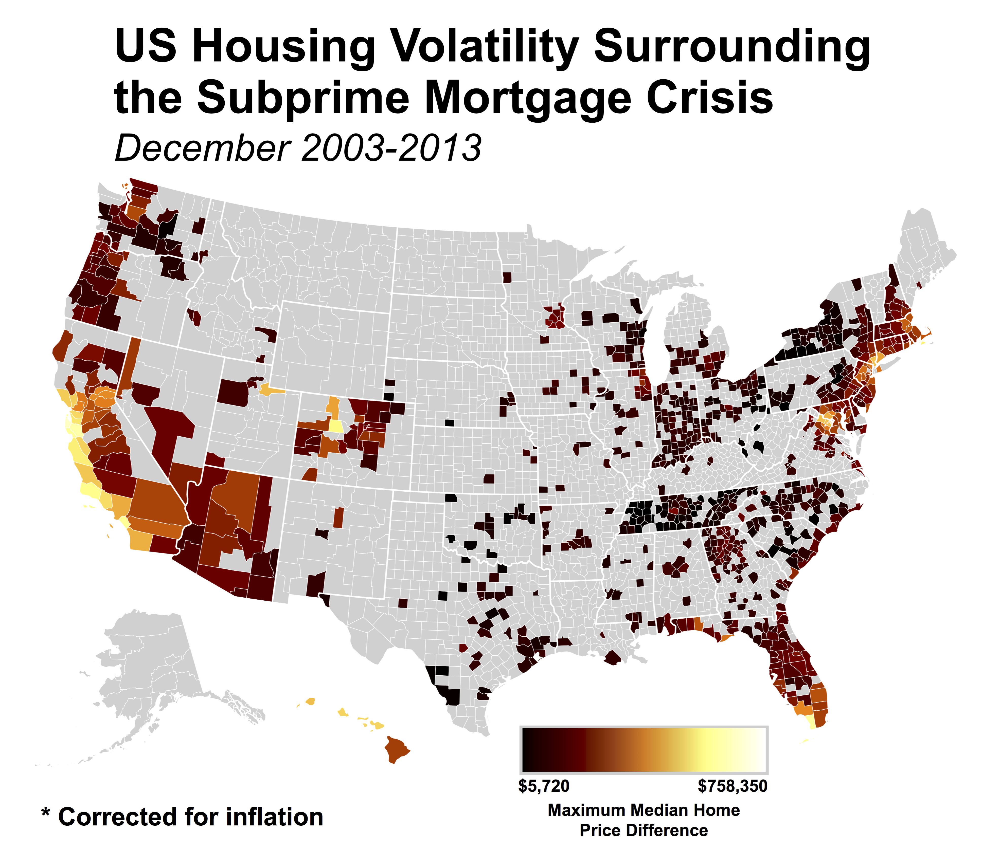

In [57]:
Image(filename='non_norm_volatility_map.jpg') 

And here's the one where we divided each maximum difference by the average (of the median home prices) across the years we are considering.

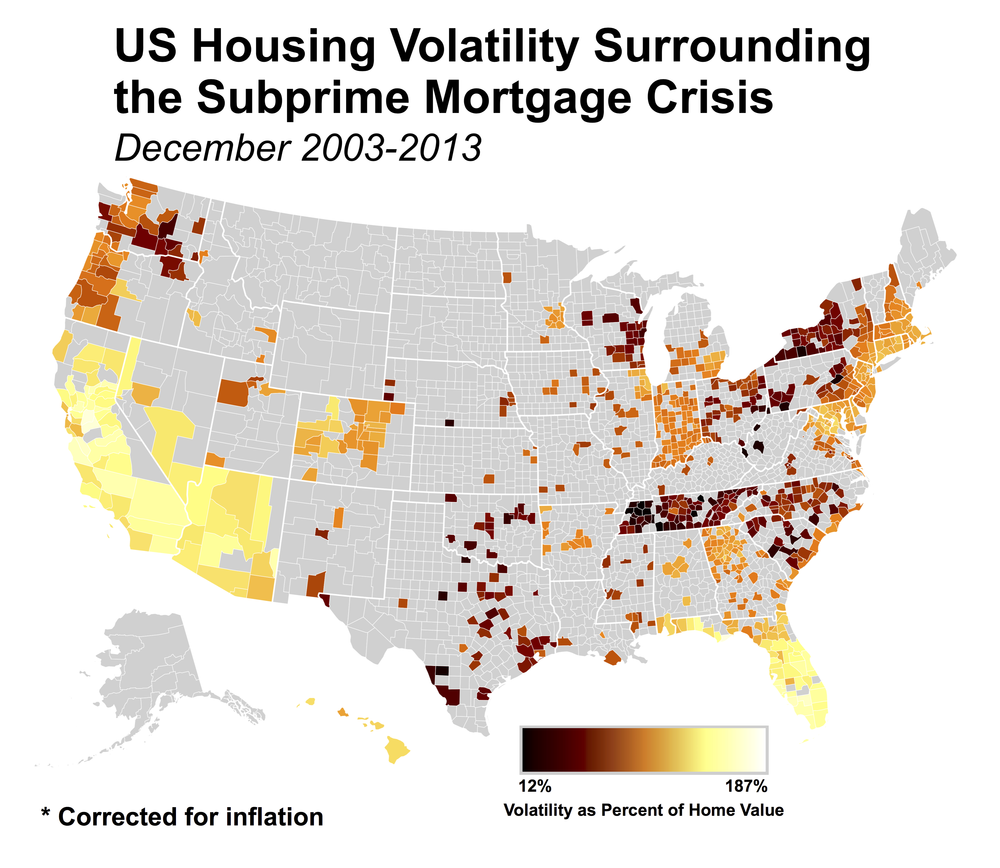

In [35]:
Image(filename='vol_norm_percent.jpg') 

Based on the volatility maps, we can see that the most significant variation in housing prices occurred around the coasts, specifically in FL and CA when we consider the volatility as a percentage of home price. As an investor, this sort of housing market volatility in these regions can be both a blessing and a curse, leading to significant profits if you buy when prices are cheapest, but staggering losses if you decide to invest when the market is peaking. Through our temporal analysis of the housing market over the nineteen year period from 1996-2014, we now have a better understanding of the overall trends that this important facet of the national economy has undergone, especially during a time as critical as the subprime mortgage crisis and national recession.

## Sources: 
https://www.gaslampmedia.com/download-zip-code-latitude-longitude-city-state-county-csv/

http://datamapper.geo.census.gov/map.html

http://www.zillow.com/research/data/

State name abbreviations: http://www.fonz.net/blog/archives/2008/04/06/csv-of-states-and-state-abbreviations/

County population change 2000-2010: http://www.census.gov/population/www/cen2010/cph-t/cph-t-1.html

Information about creating the US counties map: http://flowingdata.com/2009/11/12/how-to-make-a-us-county-thematic-map-using-free-tools/

US Crime data collected from the FBI Uniform Crime Reports Crime Statistics: https://www.fbi.gov/stats-services/crimestats 

# AND NOW FOR SOME CAT VIDEOS!

In [12]:
from IPython.display import YouTubeVideo
vid = YouTubeVideo("PCMNLyoot_Q")
display(vid)